<a href="https://colab.research.google.com/drive/1ih-WX0X8oKMBWf94hOQsDUn5lR3nuQxa#scrollTo=view-in-github" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Style Transfer Using GAN of MRI Images(T1 to T2 & vice-versa)**




## **SUBMITTED BY:**

**Nishit Goyal** : nits.gyl@gmail.com        



### <b><u>Problem statement:</u></b> 

To build a Generative adversarial model(modified U-Net) which can generate artificial MRI images of different contrast levels from existing MRI scans.

### **Background:**    
*Misdiagnosis in healthcare poses significant risks to patients. As radiologists face increasing workloads, there is a growing need for Artificial Intelligence to support them in making accurate decisions.

Magnetic Resonance Imaging (MRI) plays a crucial role in medical imaging, offering excellent soft tissue contrast through various mechanisms, such as T1-weighted and T2-weighted images. However, radiologists often require multiple contrast images to make precise diagnoses, which can be expensive and challenging to obtain.

Deep learning offers a solution through style transfer, enabling the generation of synthetic MRI images with different contrast levels from existing scans. This approach enhances diagnostic accuracy by providing additional imaging perspectives.

A CycleGAN model can be employed to convert the style of one MRI scan into another, improving the interpretation of medical images. For instance, T2-weighted images can be generated from T1-weighted scans, and vice versa, facilitating better clinical insights.*

##### <b>T1 v T2 images</b>

In T1-weighted MRI images, fat appears white, while in T2-weighted images, both fat and water appear white. These two types of images, known as T1 and T2 images, are fundamental in MRI-based diagnostics.

The difference lies in the timing of radiofrequency (RF) pulse sequences used during the scan:

- T1-weighted images emphasize fat, producing bright signals from fatty tissues within the body.
- T2-weighted images highlight both fat and water, making them useful for identifying fluid-filled or edema-rich areas.

This distinction in contrast helps radiologists obtain complementary insights into tissue composition and abnormalities.

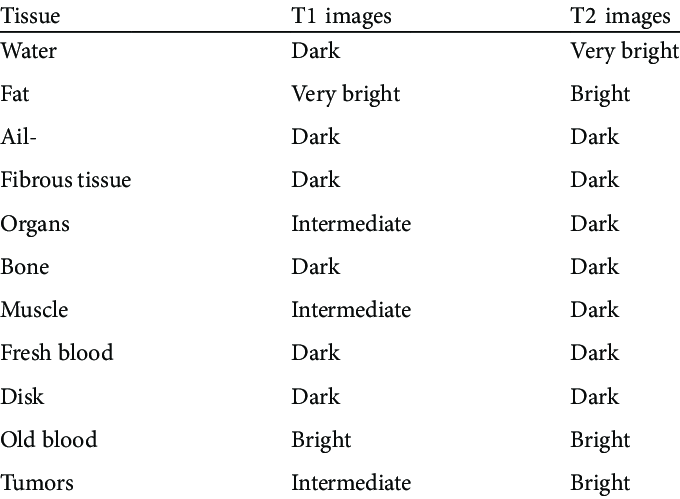

## **Project Pipeline**   
In this notebook, we will create T2 weighted images from T1 weighted MRI image and vice-versa.

Below sequence is followed for given problem statement:

***1. Importing Libraries***     
***2. Data Understanding***
  - Basic EDA
  - Data loading
  - Sample data visualization  

***3. Image Processing***
  - Data normalization
  - Data resizing
  - Data reshaping
  - Batch and shuffling of data
  - Data Augmentation

***4. Model Building*** 
   - Instance Normalization
   - Downsampling, Upsampling and Unet
   - Generator Building using Unet
   - Discriminator Building      

***5. Model Training***             
  - Declare Loss type
  - Calculate Discriminator Loss
  - Calculate Generator Loss
  - Cycle Loss
  - Identity Loss
  - Optimizer
  - Checkpoint Initialization
  - Training Flow     
   
***6. Testing Model***         
***7. Generating a GIF***          

In [ ]:
#Import all the required libraries to python 
!pip install tensorflow 
!pip install keras
!pip install matplotlib
!pip install scikit-image
!pip install imageio
!pip install glob

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement glob (from versions: none)
ERROR: No matching distribution found for glob


## **Importing Libraries**  

In [ ]:
#Import all the required libraries

# Data Science 
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

# Deep Learning 
import tensorflow as tf

# Image Preprocess 
import skimage
from skimage.transform import resize
import imageio
import cv2
import PIL
from PIL import Image

# OS Navigation 
import glob
import os
import pathlib
import sys
from sys import platform
import time

# Ignore Warnings 
import warnings
warnings.filterwarnings("ignore")

# Importing tensorflow to build models
from tensorflow import keras
from tensorflow.keras import layers, Sequential
#Importing necessary library to import the images stored in local system
from tensorflow.keras.utils import image_dataset_from_directory
# Importing required libraries
from tensorflow.keras.utils import plot_model
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, Activation, Flatten, Conv2D, Conv2DTranspose
from keras.utils.vis_utils import plot_model

In [ ]:
# Printing all the version of require libraries 
print("Numpy : {}" .format(np.__version__))
print("matplotlib : {}" .format(matplotlib.__version__))
print("tensorflow : {}" .format(tf.__version__))
print("skimage : {}" .format(skimage.__version__))
print("imageio : {}" .format(imageio.__version__))
print("PIL : {}" .format(PIL.__version__))
print("sys : {}" .format(sys.version))

Numpy : 1.22.4
matplotlib : 3.7.1
tensorflow : 2.12.0
skimage : 0.19.3
imageio : 2.25.1
PIL : 8.4.0
sys : 3.10.11 (main, Apr  5 2023, 14:15:10) [GCC 9.4.0]


## **Data Loading**

In [ ]:
# mounting Google drive on colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!mkdir '/content/Capston_MRI_Style_Transfer_using_GAN' # creating a new directory that serves as root
!gdown --id '1T4bQCnsHeVFxFpCCkbt5E74-luHz6rqb' # downloading the data set (RAR format) in the session

# https://drive.google.com/file/d/1T4bQCnsHeVFxFpCCkbt5E74-luHz6rqb/view?usp=share_link

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1T4bQCnsHeVFxFpCCkbt5E74-luHz6rqb
To: /content/MRI+T1_T2+Dataset.RAR
100% 1.82M/1.82M [00:00<00:00, 205MB/s]


In [ ]:
# unarchieving the dataset from the session storage and moving to the created root folder
!pip install patool  # https://pypi.org/project/patool/
import patoolib
patoolib.extract_archive('/content/MRI+T1_T2+Dataset.RAR', outdir='/content/Capston_MRI_Style_Transfer_using_GAN')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.5/77.5 kB 3.9 MB/s eta 0:00:00
patool: Extracting /content/MRI+T1_T2+Dataset.RAR ...
patool: running /usr/bin/unrar x -- /content/MRI+T1_T2+Dataset.RAR
patool:     with cwd='/content/Capston_MRI_Style_Transfer_using_GAN'
patool: ... /content/MRI+T1_T2+Dataset.RAR extracted to `/content/Capston_MRI_Style_Transfer_using_GAN'.


'/content/Capston_MRI_Style_Transfer_using_GAN'

In [ ]:
# setting path to the T1 an T2 datasets
T1_path = pathlib.Path('/content/Capston_MRI_Style_Transfer_using_GAN/Tr1/')
T2_path = pathlib.Path('/content/Capston_MRI_Style_Transfer_using_GAN/Tr2/')

## **Data Understanding:**     
The data from the Given data set (`MRI+T1_T2+Dataset.RAR`) containing both T1 and T2 MRI images in RGB format of base size (217 x 181). Given images should be preprocessed for further analysis. 

The T1 and T2 MRI Images included in the dataset are not related in any way since we have an unpaired dataset here. Hence we would be using cycleGAN in this problem

### **Basic EDA**        

In [ ]:
# Reading sample image to check dimension
base_dir = '/content/Capston_MRI_Style_Transfer_using_GAN/Tr1/TrainT1'
sample = cv2.imread(str(base_dir)+"/Image #10.png")
sample.shape

(217, 181, 3)

In [ ]:
# verifying the image count in the dataset
T1_image_count = len(list(T1_path.glob('*/*.png'))) # all the data inside the dataset are in PNG format
T2_image_count = len(list(T2_path.glob('*/*.png')))

print('Number of images in T1 directory --> ',T1_image_count)
print('Number of images in T2 directory --> ',T2_image_count)

Number of images in T1 directory -->  43
Number of images in T2 directory -->  46


### **Basic Data Visualization**

Found 43 files belonging to 1 classes.
T1 data examples


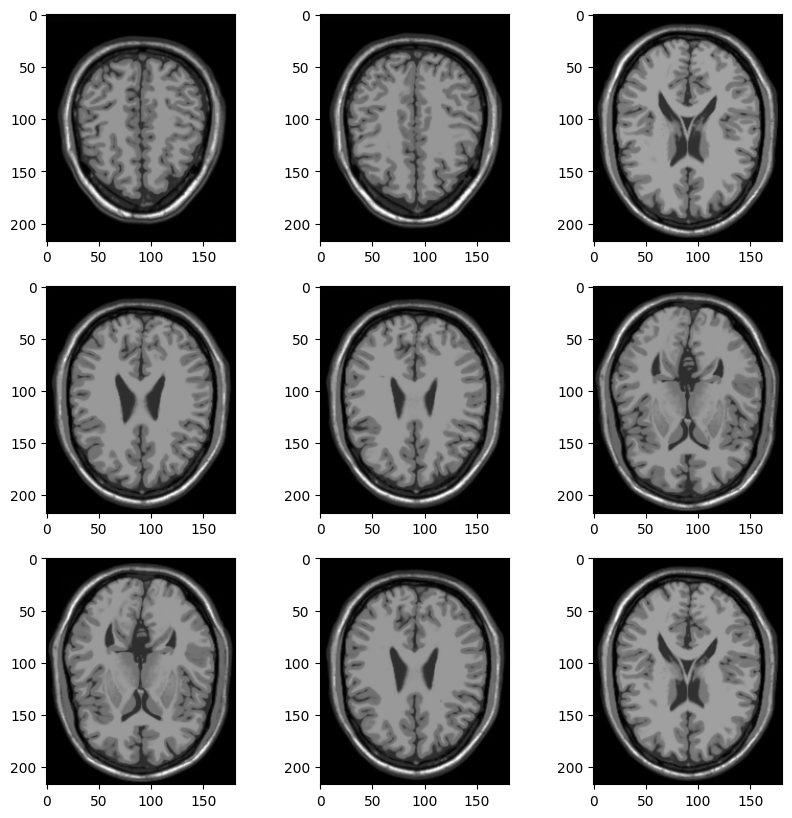

In [ ]:
# Setting input image sizes 
IMG_HEIGHT = 217
IMG_WIDTH = 181

# Loading T1 images
images_T1 = image_dataset_from_directory(T1_path, seed = 123, shuffle = True, labels = None,
                                         image_size=(IMG_HEIGHT, IMG_WIDTH), batch_size=64)
# Visualizing data from T1 dataset
plt.figure(figsize=(10, 10))
for images in images_T1.take(1):
  print("T1 data examples")
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))

Found 46 files belonging to 1 classes.
T2 data examples



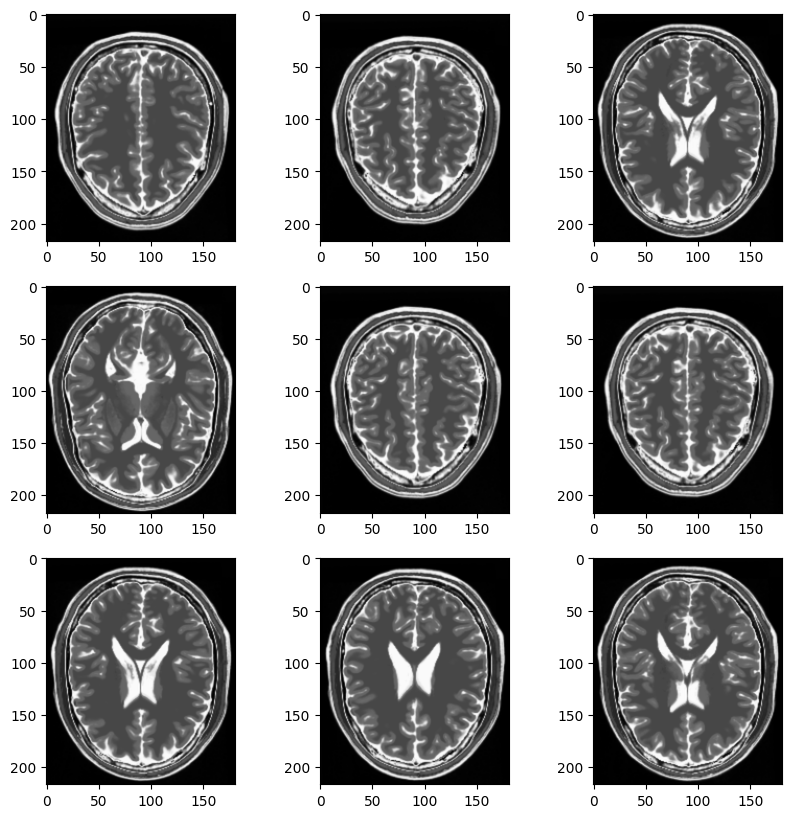

In [ ]:
# Loading T2 images
images_T2 = image_dataset_from_directory(T2_path, seed = 123, shuffle = True, labels = None,
                                         image_size=(IMG_HEIGHT, IMG_WIDTH), batch_size=64)
# Visualizing data from T2 dataset
plt.figure(figsize=(10, 10))
for images in images_T2.take(1):
  print("T2 data examples\n")
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))

In [ ]:
# Checking range of values of the pixels making up the image in T1 data
image_batch = next(iter(images_T1))
first_image = image_batch[0]
print("T1 data pixel value range: ", np.min(first_image), np.max(first_image))

T1 data pixel value range:  0.0 255.0


In [ ]:
# Checking range of values of the pixels making up the image in T2 data
image_batch = next(iter(images_T2))
first_image = image_batch[0]
print("T2 data pixel value range: ", np.min(first_image), np.max(first_image))

T2 data pixel value range:  0.0 255.0


# **Data Preprocessing**
1. Data Normalization
2. Data Resizing
3. Data Reshaping
4. Batch and Shuffle Data
5. Data Augmentation

### **Image Processing:**          

As part of image preprocessing following steps will be performed on the data set

1. Reshape, shuffle, batch and convert the image to grayscale (returned as T1 and T2)
  
  *Reshaping the image size from base size (217 x 181) to (256 x 256) using batch size of 1* 
2. Normalize the image (Data Re-scaling in the range of [-1,1])
3. Data Augmentation (Here performing random horizontal flip on the image)

### **1. Performing image load from directory, reshape, shuffle, batch and convert to grayscale (Preprocessing-1)**
 - **Data Resizing, Data Reshaping, Batch and Shuffle Data During Load**  
 - **Reshape the data to a single channel**

In [ ]:
 # method to load the images from the given directory path
def data_load(directory):
  image = tf.keras.preprocessing.image_dataset_from_directory(directory, 
                                                    labels='inferred', 
                                                    label_mode='int', 
                                                    class_names=None, 
                                                    color_mode='grayscale', 
                                                    batch_size=1, 
                                                    image_size=(256, 256), 
                                                    shuffle= True, 
                                                    seed=42, 
                                                    validation_split=None, 
                                                    subset=None, 
                                                    interpolation='bilinear', 
                                                    follow_links=False)
  return image

In [ ]:
# performing image load from directory, reshape, shuffle, batch and convert to grayscale (preprocessing-1)
T1 = data_load(T1_path)
T2 = data_load(T2_path)

Found 43 files belonging to 1 classes.
Found 46 files belonging to 1 classes.


### **2. Data Normalization (Preprocessing-2)**

In [ ]:
# method to normalize single channel image (preprocessing-2)
def normalize(image):
  image = tf.cast(image, tf.float32)
  image = (image - 127.5) /127.5
  return image

### **3. Data Augmentation (Preprocessing-3)**    

In [ ]:
# perform random horizontal flip and normalize the image (preprocessing-3)
def preprocess_image_train(image, label):
  image = tf.image.random_flip_left_right(image)
  image = normalize(image)
  return image

In [ ]:
# preprocessing the data under T1 and T2
T1 = T1.map(preprocess_image_train)
T2 = T2.map(preprocess_image_train)

### **Tensor Specifications for the Preprocessed images**

In [ ]:
# printing the tensor specifications for the preprocessed images
print(T1)
print(T2)

<_MapDataset element_spec=TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None)>
<_MapDataset element_spec=TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None)>


### **Input Pipeline is obtained**

In [ ]:
# iterating through all the preprocessed images and caching them
sample_T1 = next(iter(T1))
sample_T2 = next(iter(T2))

In [ ]:
print("Shape of individual Sample T1 image: ",sample_T1[0].shape,"\n")
print("Shape of individual Sample T2 image: ",sample_T2[0].shape)

Shape of individual Sample T1 image:  (256, 256, 1) 

Shape of individual Sample T2 image:  (256, 256, 1)


### **Visualization of Preprocessed Images**  

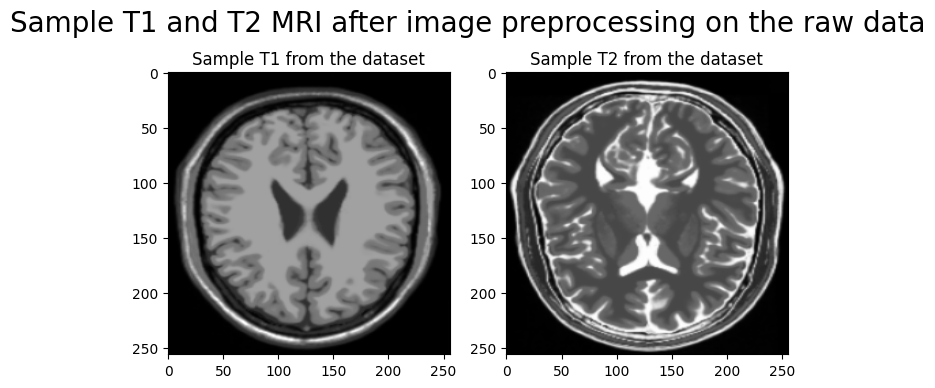

In [ ]:
# visualizing preprocessed T1 and T2 from the input dataset
f, ax = plt.subplots(1,2, figsize=(8,8))
f.suptitle('Sample T1 and T2 MRI after image preprocessing on the raw data', fontsize=20, y=0.75)
ax[0].set_title('Sample T1 from the dataset')
ax[0].imshow(sample_T1[0].numpy()[:, :, 0], cmap = 'gray')
ax[1].set_title('Sample T2 from the dataset')
ax[1].imshow(sample_T2[0].numpy()[:, :, 0], cmap = 'gray')
plt.show()

# **Model Building**
1. Instance Normalization
2. Downsampling, Upsampling and Unet
3. Generator Building using Unet
4. Discriminator Building


### **Instance Normalization**       

Instance Normalization are specially used with Style Transfer, where Separate Normalization is performed for each sample we perform channelwise Normalization.

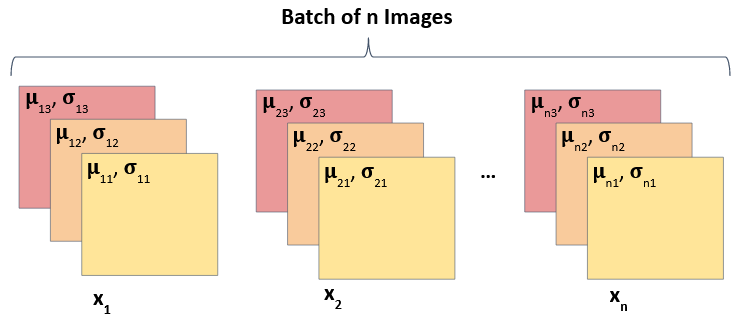 

In [ ]:
class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    
    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

### **Downsample** 
- Uses Conv2D layers
- Reduces the dimension with each new layer
- Model convolution is applied to reduce the image size and increase image depth (encoder)


In [ ]:
# method to downsample images using convolution, downsamples the image dimensions
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    # Add Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Add Parametric Relu Activation
    result.add(tf.keras.layers.PReLU())
    return result

### **Upsample**  
- Uses Transposed Convolution layers
- Increases the dimensions
- Transposed convolution is applied which increases the image size (decoder)

In [ ]:
# method to upsample the downsampled images connected to a transformer block, upsamples the image dimension
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Add Normalization Layer
    result.add(InstanceNormalization())
    # Conditionally add Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    # Add Relu Activation Layer
    result.add(tf.keras.layers.ReLU())
    return result

### **Generator**  

Generator follows **U-net architecture**  which is fairly simple architecture; however, to create the skip connections between the encoder and decoder, we will need to concatenate some layers. So the Keras Functional API is most appropriate for this purpose.

U-Net is able to localize and distinguish borders by classifying on every pixel, with both input and output images being of same size

Here, Generator generates synthetic images(T1 to T2 and vice versa) using given random normal initializer 

## **Unets**
- Unets take images as input and translate it into another Image. <p>
- To do this they first use Downsampling on Input Image to learn the latent characteristics of input image and then use Upsampling to use this knowledge to translate it into another image. <p>
- The last layer in the downsampling process is the bottleneck layer. <p>
- Each downsampling layer (except the bottleneck layer) has a corresponding upsampling layer. <p>
- An important characteristic is the use of skip connections, which retain the background information from the downsampling layers and transfer them to the corresponding upsampling layer. Bottleneck layer, obviously, has no skip connections.

<center>

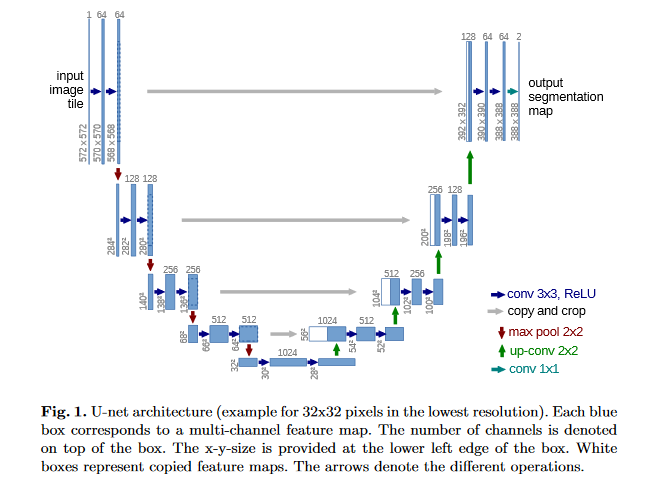

</center>

In [ ]:
# Building U-net generator which is a combination of Convolution + Transposed Convolution Layers
def unet_generator():
  inputs = tf.keras.layers.Input(shape=[256,256,1]) # input layer
  # increasing the image size from (256 x 256 x 1) --> (1 x 1 x 512)
  down_stack = [
      downsample(128, 4, apply_norm=False), 
      downsample(256, 4), 
      downsample(512, 4), 
      downsample(512, 4), 
      downsample(512, 4), 
      downsample(512, 4), 
      downsample(512, 4), 
      downsample(512, 4), 
    ]
  # decreasing the image size from (1 x 1 x 512) --> (128 x 128 x 256)
  up_stack = [
      upsample(512, 4, apply_dropout=True),
      upsample(512, 4, apply_dropout=True), 
      upsample(512, 4, apply_dropout=True), 
      upsample(512, 4), 
      upsample(512, 4), 
      upsample(256, 4), 
      upsample(128, 4),
    ]
  # (125 x 128 x 256) --> (256 x 256 x 1)
  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(1, 4,
                                          strides=2,
                                          padding='same',
                                          kernel_initializer=initializer,
                                          activation='tanh') 

  x = inputs
  # skip connections is used to concatenate encoder with decoder
  skips = []
  # downsampling
  for down in down_stack:
    x = down(x)
    skips.append(x)
  skips = reversed(skips[:-1])
  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])
  x = last(x)
  return tf.keras.Model(inputs=inputs, outputs=x) # returns U-net generator model

To summarize the U-net generator the input image (256 x 256 x 1) is increased to (1 x 1 x 512) and brought back to (256 x 256 x 1) using encoder [which learns the image irrespective of its loaction] and decoder [details are captured here] using skip connections to get precise locations, feature maps from corresponding encoder level is concatenated with output of transposed convolutional layers

## **Generators**  
Generator is a Unet Network since we want to translate T1 images to T2 and vice-versa.

### **Initializing the Generator**

In [ ]:
# initializing the generator
generator_g = unet_generator() # T1 images will transform to T2
generator_f = unet_generator() # T2 images will transform to T1

generator_g learns to transform image from T1 to T2

generator_f learns to transform image from T2 to T1

### **Visualize Generator Model Architecture**   

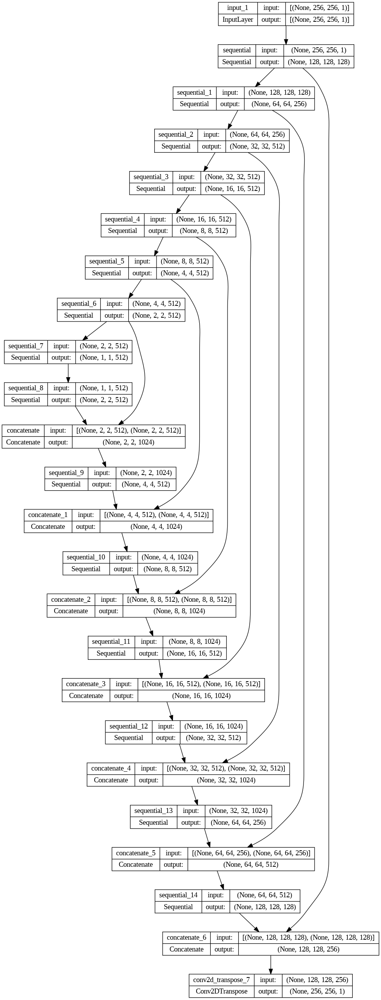

In [ ]:
# Visualize generator model architecture
plot_model(generator_g, show_shapes=True, show_layer_names=True)

### **Summarizing U-net Generator**  

In [ ]:
# summarizing U-net Generator
generator_g.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 128, 128, 12  2099200     ['input_1[0][0]']                
                                8)                                                                
                                                                                                  
 sequential_1 (Sequential)      (None, 64, 64, 256)  1573376     ['sequential[0][0]']             
                                                                                              

### **Plotting the Original and Generated images using created Generator**

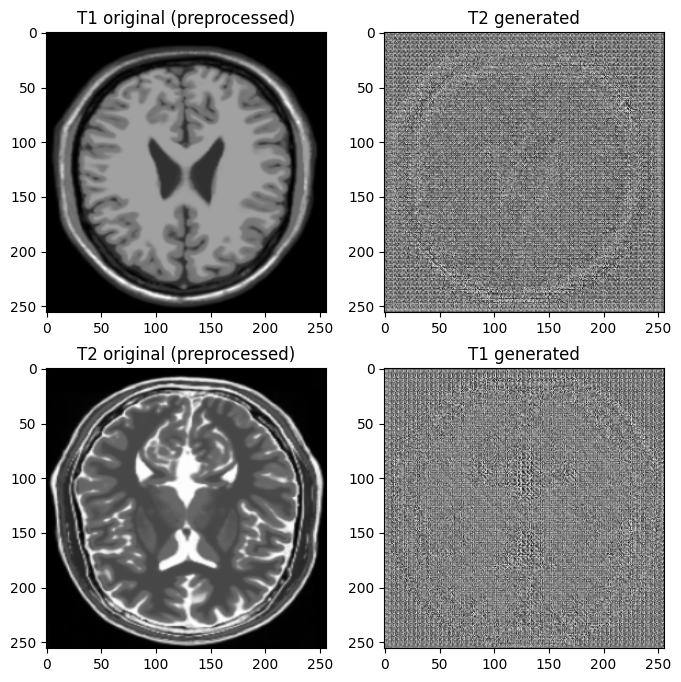

In [ ]:
# plotting the original and generated images using created Generator

to_T2 = generator_g(sample_T1)
to_T1 = generator_f(sample_T2)
img_array = [sample_T1, to_T2, sample_T2, to_T1]
img_title = ['T1 original (preprocessed)', 'T2 generated', 'T2 original (preprocessed)', 'T1 generated']

f, ax = plt.subplots(2, 2, figsize=(8,8))
ax[0,0].set_title(img_title[0])
ax[0,0].imshow(img_array[0][0].numpy()[:, :, 0], cmap='gray')
ax[0,1].set_title(img_title[1])
ax[0,1].imshow(img_array[1][0].numpy()[:, :, 0], cmap='gray')
ax[1,0].set_title(img_title[2])
ax[1,0].imshow(img_array[2][0].numpy()[:, :, 0], cmap='gray')
ax[1,1].set_title(img_title[3])
ax[1,1].imshow(img_array[3][0].numpy()[:, :, 0], cmap='gray')
plt.show()

###  **Visualizing the U-net model(generator) using plot_model**   

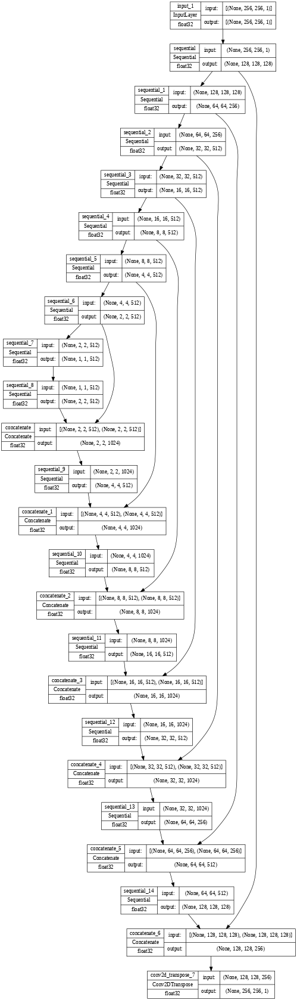

In [ ]:
# visualizing the U-net model(generator) using plot_model
# explains the transformations iccured in U-net generator
tf.keras.utils.plot_model(
    generator_g,
    to_file="unet_generator_model.png",
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=48)

## **Discriminator**     
- Discriminator is a traditional CNN, which we use to classify the Images. - It only uses Downsampling hence. Discriminator shall classify a portion of the image generated from the generator (input image) as fake or real.
- Both Discriminators have same architecture.

### **Building the Discriminator**     

In [ ]:
# Building the discriminator
# Discriminators only contain Convolutional layers and no Transposed Convolution is used.
def discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)
  # add input layer of size (256,256,1)
  inputs = tf.keras.layers.Input(shape=[256,256, 1], name='input_image')
  x = inputs

  # add downsampling step here
  down1 = downsample(128, 4, False)(x) 
  down2 = downsample(256, 4)(down1) 
  down3 = downsample(512, 4)(down2) 
  
  # add a padding layer here
  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) 
  conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) 
  norm1 = InstanceNormalization()(conv)
  leaky_relu = tf.keras.layers.PReLU()(norm1)

  # apply zero padding layer
  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) 
  last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) 
  return tf.keras.Model(inputs=[inputs], outputs=last) 

Discriminator uses an image patch of (30 x 30 x 1) from the generator to verify the synthetic image as real or fake

### **Initializing the Discriminators**      

In [ ]:
# Initializing the discriminators
discriminator_x = discriminator() # separates real T1 from generated T1
discriminator_y = discriminator() # separates real T2 from generated T2

discriminator_x learns to differentiate between image T1 and generated image T1.

discriminator_y learns to differentiate between image T2 and generated image T2

### **Summarizing the Discriminator**       

In [ ]:
# summarizing the discriminator
discriminator_x.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 256, 256, 1)]     0         
                                                                 
 sequential_30 (Sequential)  (None, 128, 128, 128)     2099200   
                                                                 
 sequential_31 (Sequential)  (None, 64, 64, 256)       1573376   
                                                                 
 sequential_32 (Sequential)  (None, 32, 32, 512)       2622464   
                                                                 
 zero_padding2d (ZeroPadding  (None, 34, 34, 512)      0         
 2D)                                                             
                                                                 
 conv2d_19 (Conv2D)          (None, 31, 31, 512)       4194304   
                                                           

### **Visualize Discriminator Model Architecture**    

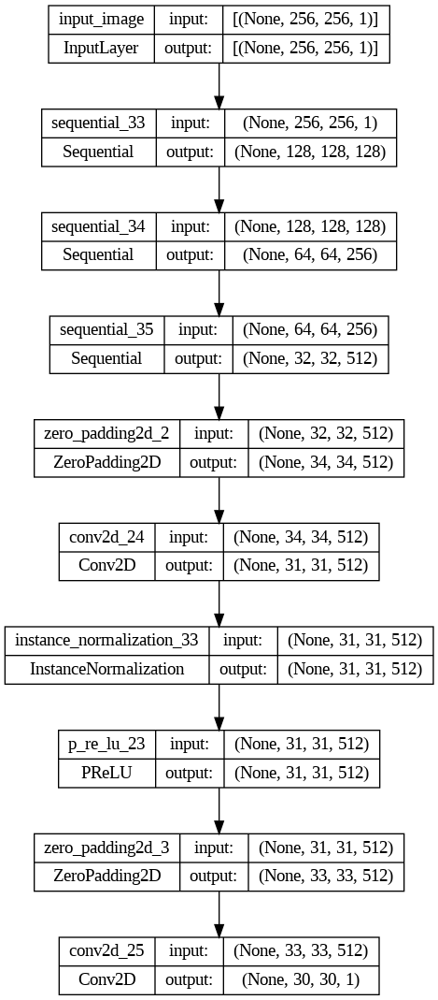

In [ ]:
# Visualize discriminator model architecture
plot_model(discriminator_y, show_shapes=True, show_layer_names=True)

### **Visualising the created Discriminator Model using plot_model**   

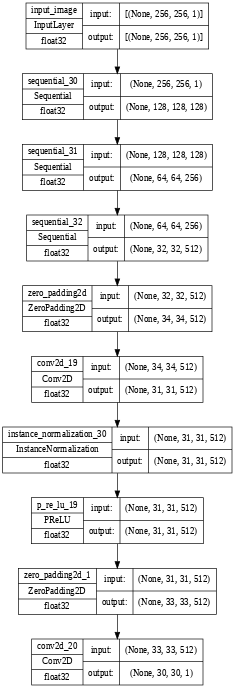

In [ ]:
# visualising the created Discriminator model using plot_model
tf.keras.utils.plot_model(
    discriminator_x,
    to_file="discriminator_model.png",
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=48)

# **Model Training**  
1. Declare Loss type
2. Calculate Discriminator Loss
3. Calculate Generator Loss
4. Cycle Loss
5. Identity Loss
6. Optimizer
7. Checkpoint Initialization
8. Training Flow

### **Checking output of untrained generator**

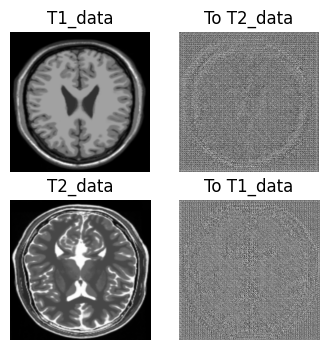

In [ ]:
to_T2_data = generator_g(sample_T1)   # Generating T2 from T1 data
to_T1_data = generator_f(sample_T2)   # Generating T1 from T2 data

plt.figure(figsize=(4, 4))

imgs = [sample_T1, to_T2_data, sample_T2, to_T1_data]
title = ['T1_data', 'To T2_data', 'T2_data', 'To T1_data']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')
plt.show()

### **1. Declare Loss type**

- Declare Loss as **Binary Cross Entropy** , since Our Discriminator is a classifier

In [ ]:
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### **2. Discriminator Loss**    

It consists of two types of losses:
1.   **Loss on Real Data:**
        - loss function of real images which is a binary cross entropy loss and ones arrays `real_loss`
2.    **Loss on Fake Data:**
        - loss from generated (fake) images which is a binary cross entropy loss of generated images and zero arrays   `generated_loss`

**Now the `total_loss` (discriminator loss) is a sum of real_loss and generated_loss**


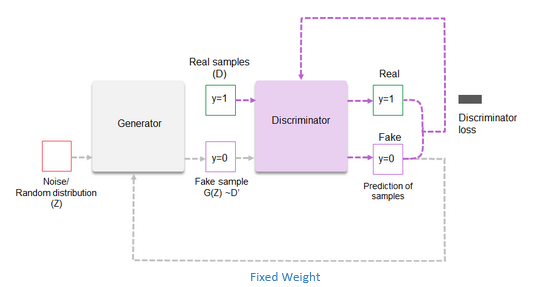

In [ ]:
# Discriminator adversarial loss

def discriminator_loss(real, generated):
  real_loss = loss_fn(tf.ones_like(real), real)
  generated_loss = loss_fn(tf.zeros_like(generated), generated)
  total_disc_loss = real_loss + generated_loss
  return total_disc_loss * 0.5   # mean of losses

### **3. Generator Loss**    

- It has only one type of loss - Discriminator Loss on Generated data
- It is a binary cross entropy loss of the synthetic images and an array of ones

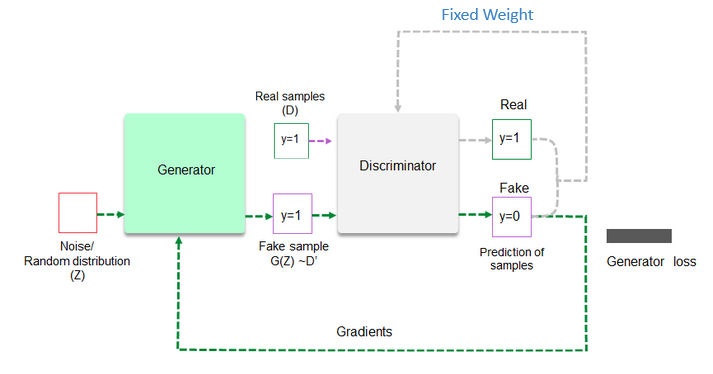

In [ ]:
# method to obtain generator loss
def generator_loss(generated):
  return loss_fn(tf.ones_like(generated), generated)

### **4. Cycle Consistency Loss**   

- When we use both of Generators sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle consistency Loss.

- It is the reduced mean of difference between real and synthetic image. Suppose if the synthetic image is translated back it should be close to original image

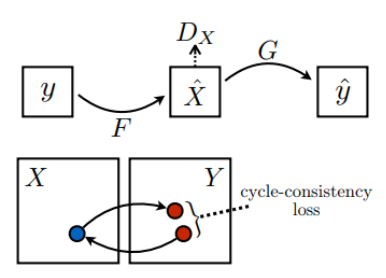

In [ ]:
LAMBDA = 10 # learning rate

# method to calculate cycle consitency loss
def cycle_consistency_loss(real_image, cycled_image):
  cyc_loss = tf.reduce_mean(tf.abs(real_image - cycled_image))  # Averages out all values in the input
  return LAMBDA * cyc_loss # Weight of 10 used as contribution of cycle loss to total loss. This is a hyperparameter.

### **5. Identity Loss**   
When we provide input image to the Generator such that no translation is needed because the image is already transformed, the difference should be minimal between original and generated image. Here also we take L1 Loss between input and output image.

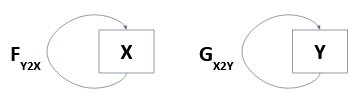

In [ ]:
# method to calculate identity loss
def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image)) # Averages out all values in the input
  return LAMBDA * 0.5 * loss

### **6. Optimizer**   
Adam optimizer is used in both generator and discriminator outputs

In [ ]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

### **7. Checkpoint Initialization**     

- Initialize checkpoints to save models
- Checkpoint - object which periodically writes checkpoints to disk.
- CheckpointManager helps in managing multiple checkpoints



In [ ]:
# number of epochs for the model to be trained
EPOCHS = 100

In [ ]:
# Directory to keep Checkpoints at each epoch
if not os.path.isdir('training_checkpoints'):
    os.mkdir('training_checkpoints')

checkpoint_path = "./training_checkpoints"

checkpoint = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

checkpoint_manager = tf.train.CheckpointManager(checkpoint, checkpoint_path, max_to_keep=EPOCHS)

# if a checkpoint exists, restore the latest checkpoint.
if checkpoint_manager.latest_checkpoint:
  checkpoint.restore(checkpoint_manager.latest_checkpoint)
  print('Latest checkpoint restored!!')

In [ ]:
# Function to show Images output by Generators while Training
def generate_images(model1, test_input1, model2, test_input2):
  prediction1 = model1(test_input1) # Image Translation from T1 to T2
  prediction2 = model2(test_input2) # Image Translation from T2 to T1
  plt.figure(figsize=(12, 8))
  display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
  title = ['Input T1', 'Predicted T2 - Epoch ' + str(epoch+1), 'Input T2', 'Predicted T1 - Epoch ' + str(epoch+1)]
  for i in range(4):
    plt.subplot(1, 4, i+1)
    plt.title(title[i])
    plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch+1))
  plt.show()

## **8. Training Flow**    

### **Model Training Steps:**       

The training consists of four broad steps

1. Get the predictions — The generator and discriminator modules are used to get the predictions
2. Calculate the loss — Various loss functions defined above are used to calculate the losses
3. Calculate the gradients using backpropagation
4. Apply the gradients to the optimizer — Adam optimizer as defined in the original paper is used for optimization

#### **Sequence of Training Flow**:    

The function below performs one flow of batch training:

1.   Generate Fake T2 and Cycled T1
2.   Generate Fake T1 and Cycled T2
3.   Generate Fake Images through T1 and T2 for Identity Loss.
4.   Calculate Discriminator Loss for Disc T1 and Disc T2 on Fake Data for Generator Training.
5.   Calculate Generator Loss on Discriminator.
6.   Calculate Cycled Loss on Cycled Images from step 1 and 2.
7.   Calculate Total Generator Loss - Disc Loss + Cycled Loss + Identity Loss
8.   Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
9.   Calculate the Gradients and update the weight and bias of models.

### **Training Step Function**   

In [ ]:
# training step function
@tf.function 
def train_step(real_x, real_y):
  # persistent is set to True because the tape is used more than once to calculate the gradients.
  with tf.GradientTape(persistent=True) as tape:
    # Generator G translates X -> Y
    # Generator F translates Y -> X.
    fake_y = generator_g(real_x, training=True) # synthetic T2 from input T1
    cycled_x = generator_f(fake_y, training=True) # T1 from synthetic T2

    fake_x = generator_f(real_y, training=True) # synthetic T1 from input T2
    cycled_y = generator_g(fake_x, training=True) # T2 from synthetic T1

    # same_x and same_y are used for identity loss.
    same_x = generator_f(real_x, training=True) # same T1 from input T1
    same_y = generator_g(real_y, training=True) # same T2 from input T2

    disc_real_x = discriminator_x(real_x, training=True) # patch from T1 input
    disc_real_y = discriminator_y(real_y, training=True) # patch from T2 input

    disc_fake_x = discriminator_x(fake_x, training=True) # patch from T1 synthetic
    disc_fake_y = discriminator_y(fake_y, training=True) # patch from T2 synthetic

    # generator loss
    gen_g_loss = generator_loss(disc_fake_y) # loss from T2 synthetic image
    gen_f_loss = generator_loss(disc_fake_x) # loss from T1 synthetic image

    # Calculate cycle loss
    total_cycle_loss = cycle_consistency_loss(real_x, cycled_x) + cycle_consistency_loss(real_y, cycled_y)

    # Total generator loss = BCE loss + cycle loss + identity loss
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    # Discriminator's loss
    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
    
  # Calculate the gradients for generator and discriminator
  generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
  
  discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables) 
  discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables) 
  
  # Apply the gradients to the optimizer
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients,generator_g.trainable_variables))
  generator_f_optimizer.apply_gradients(zip(generator_f_gradients,generator_f.trainable_variables))

  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,discriminator_x.trainable_variables))
  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,discriminator_y.trainable_variables))

### **Save Finalized Model**        

In [ ]:
# method to save finalized model trained and evaluated for further use
def final_model_save(epoch, generator_g, generator_f):
  model_save_path = '/content/model_save/'
  T1_to_T2_model = model_save_path + 'T1_to_T2_final_model.h5'
  generator_g.save(T1_to_T2_model)
  T2_to_T1_model = model_save_path + 'T2_to_T1_final_model.h5'
  generator_f.save(T2_to_T1_model)
  print('trained models saved at %06d' % (epoch+1))

### **Train the CycleGAN Model for several Epochs**    
Loop training function for number of epochs and also show the output at each step.

In [ ]:
# Declaring number of epochs of training
EPOCHS = 100

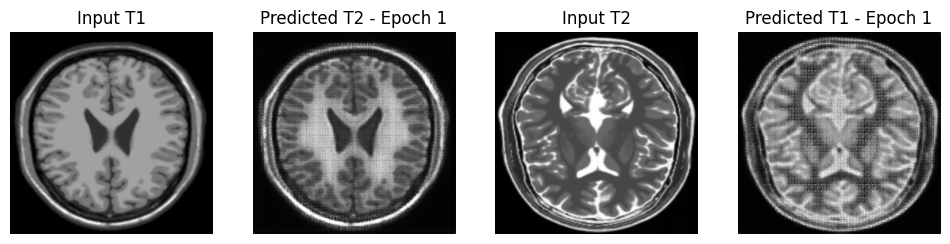

Time taken in 78 seconds for epoch 1



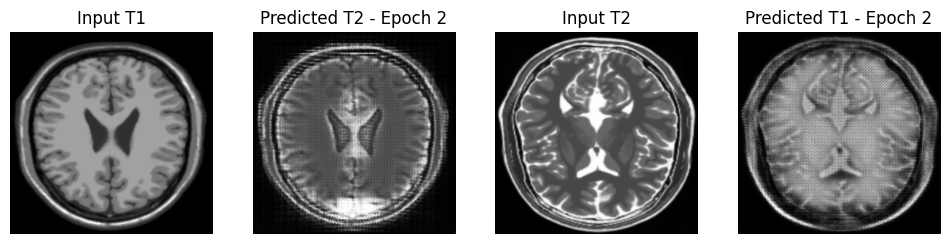

Time taken in 29 seconds for epoch 2



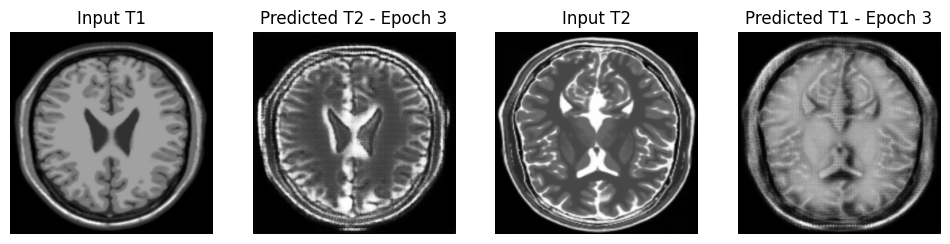

Time taken in 29 seconds for epoch 3



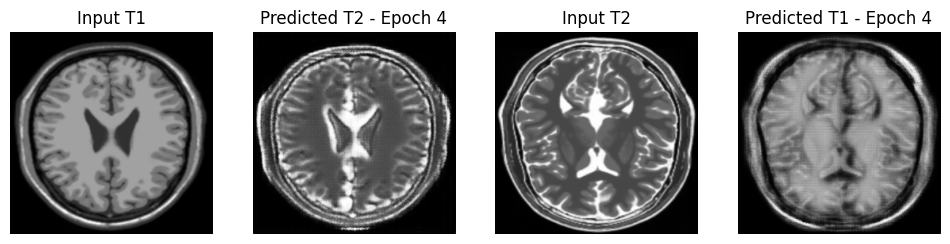

Time taken in 29 seconds for epoch 4



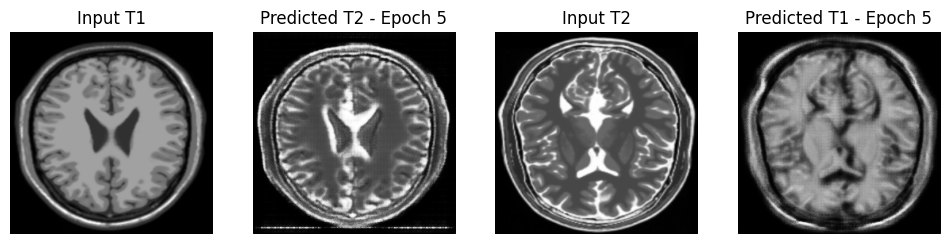

Time taken in 30 seconds for epoch 5



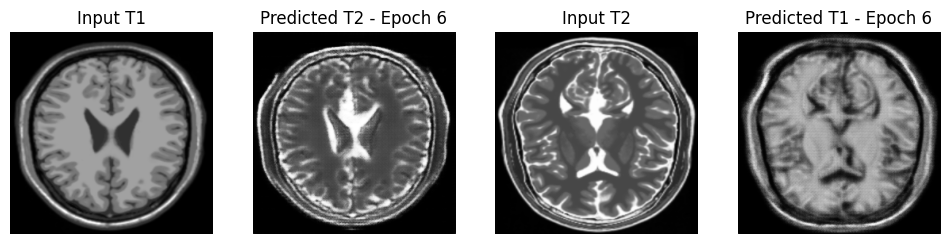

Time taken in 30 seconds for epoch 6



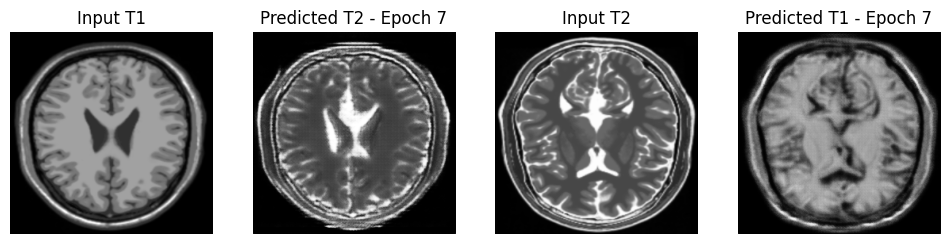

Time taken in 30 seconds for epoch 7



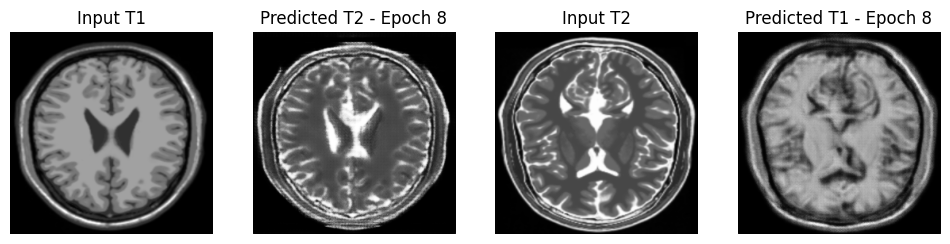

Time taken in 30 seconds for epoch 8



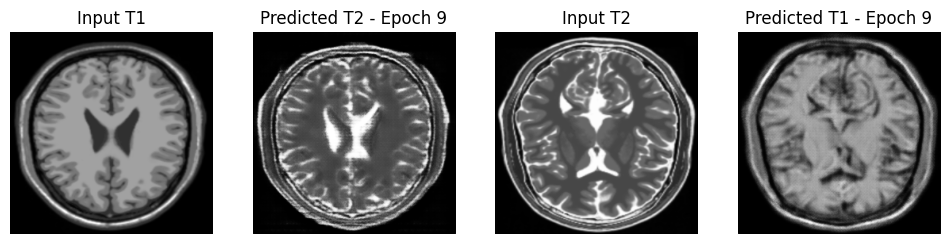

Time taken in 30 seconds for epoch 9



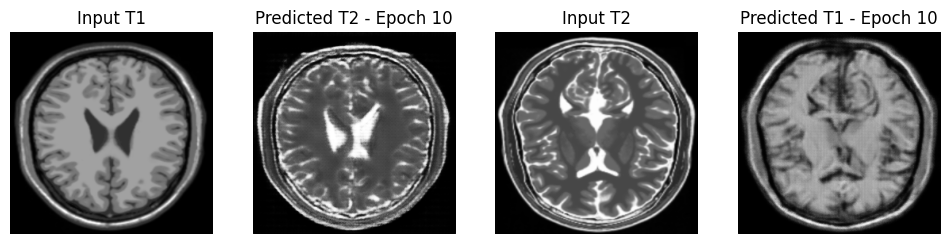

Checkpoint restored for epoch 10 at ./training_checkpoints/ckpt-1
Time taken in 39 seconds for epoch 10



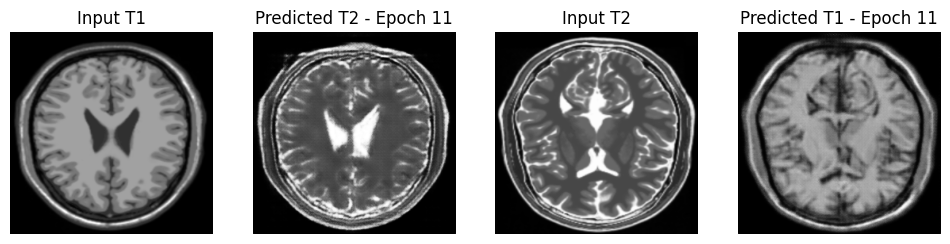

Time taken in 30 seconds for epoch 11



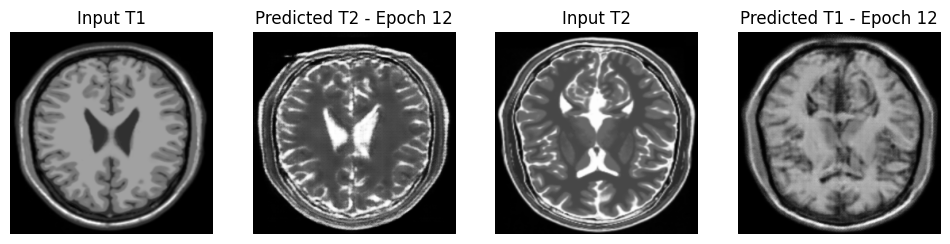

Time taken in 30 seconds for epoch 12



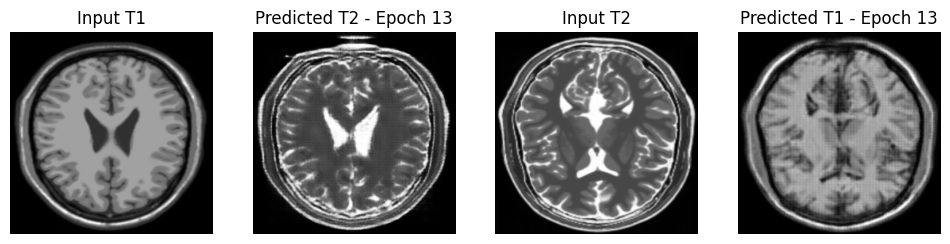

Time taken in 30 seconds for epoch 13



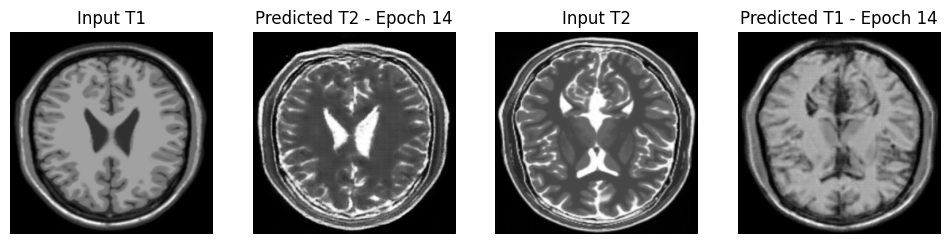

Time taken in 30 seconds for epoch 14



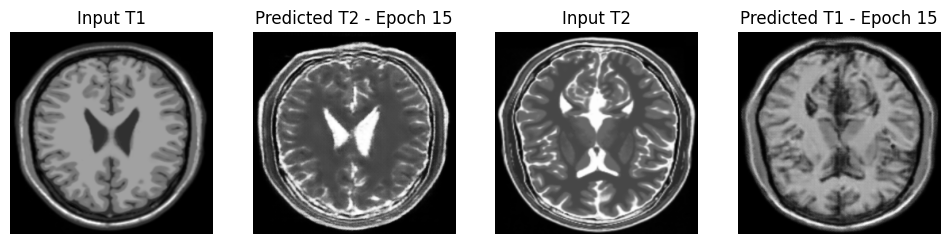

Time taken in 30 seconds for epoch 15



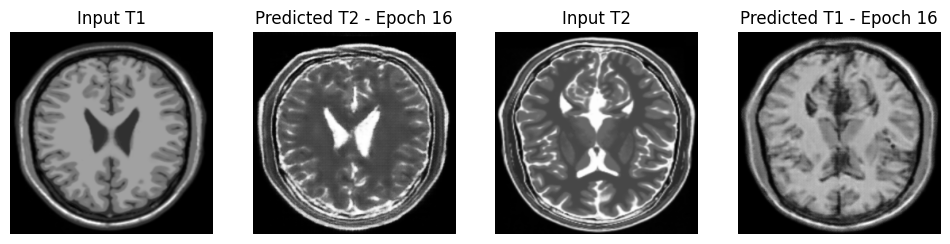

Time taken in 30 seconds for epoch 16



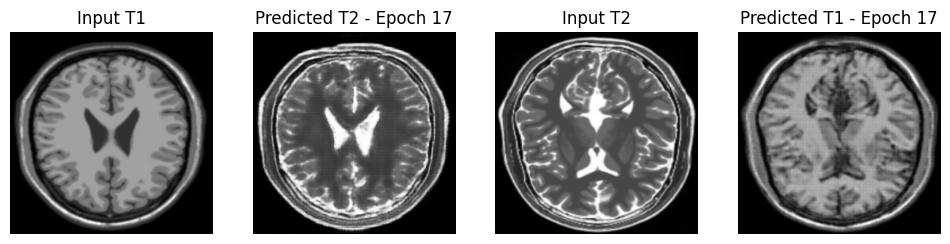

Time taken in 30 seconds for epoch 17



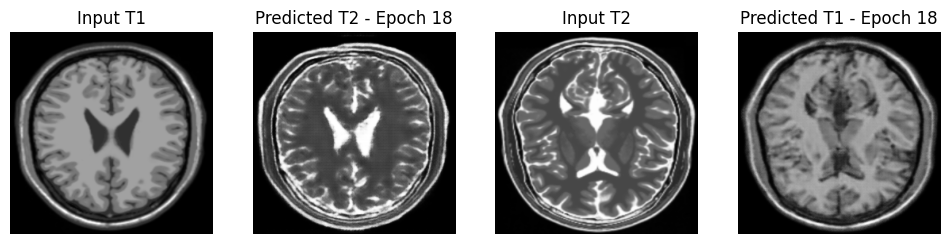

Time taken in 30 seconds for epoch 18



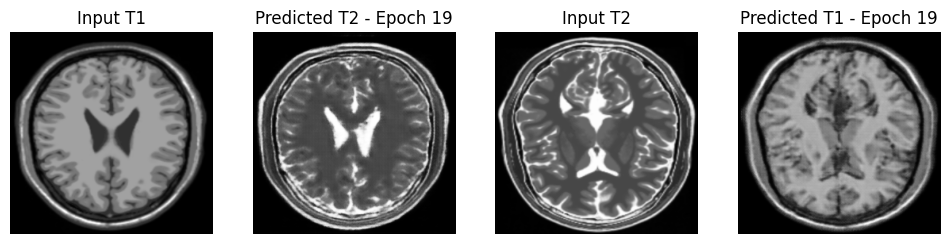

Time taken in 30 seconds for epoch 19



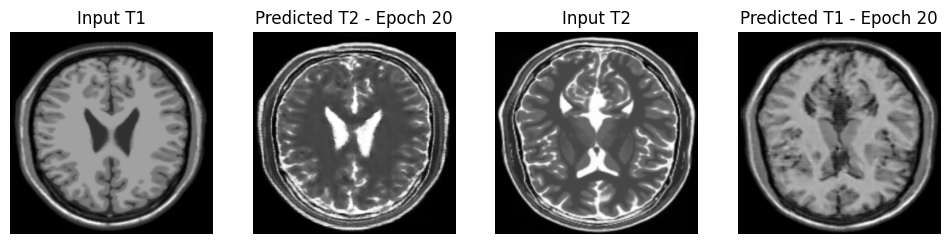

Checkpoint restored for epoch 20 at ./training_checkpoints/ckpt-2
Time taken in 39 seconds for epoch 20



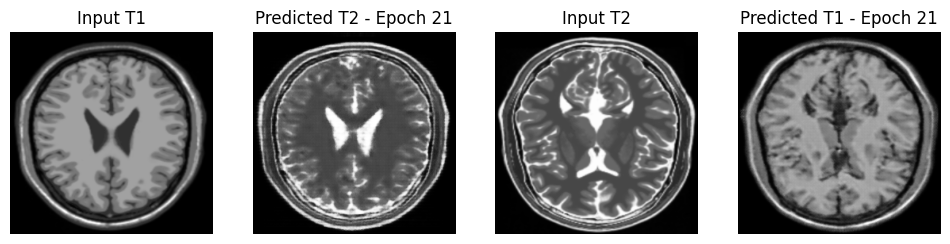

Time taken in 30 seconds for epoch 21



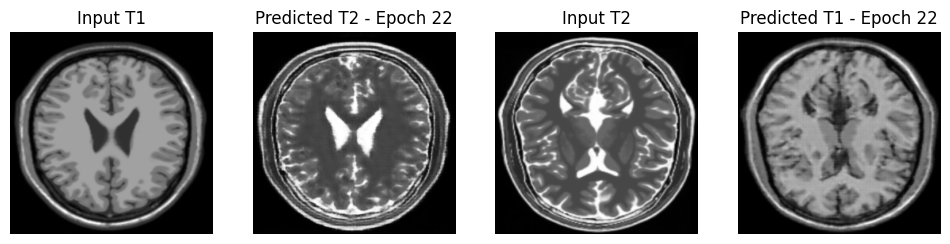

Time taken in 30 seconds for epoch 22



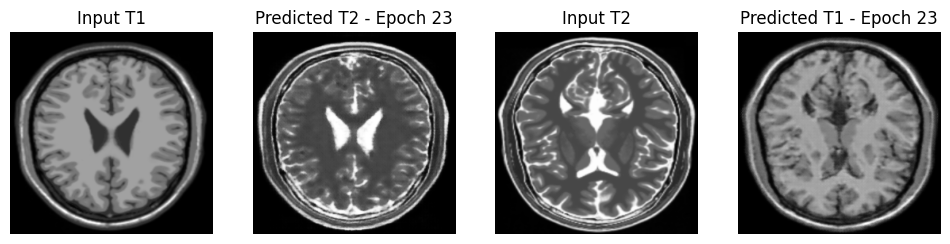

Time taken in 30 seconds for epoch 23



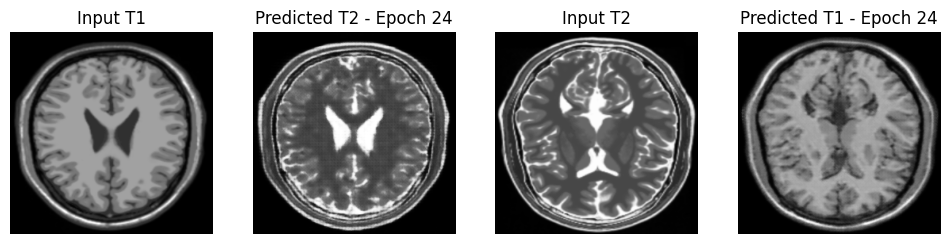

Time taken in 30 seconds for epoch 24



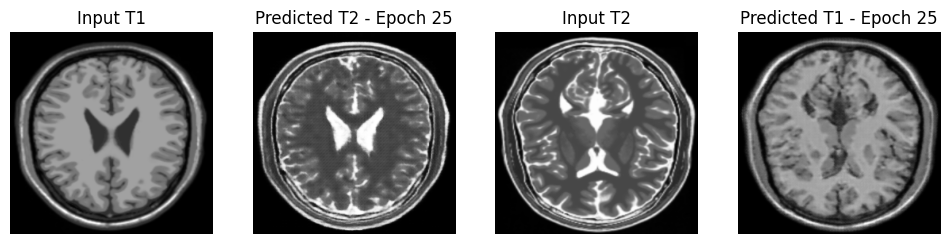

Time taken in 30 seconds for epoch 25



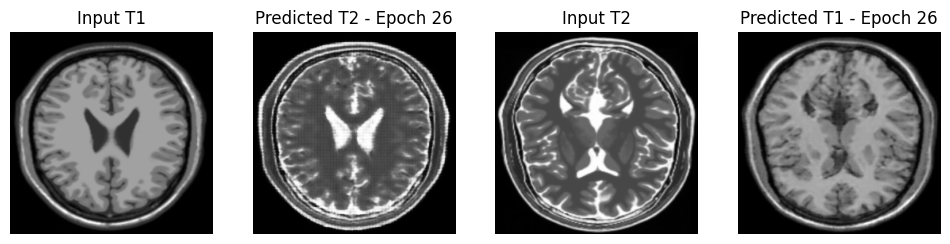

Time taken in 30 seconds for epoch 26



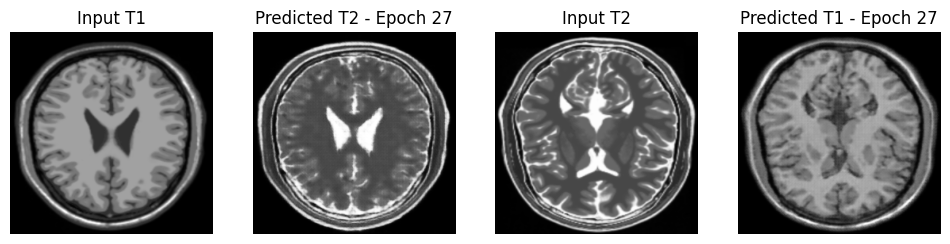

Time taken in 30 seconds for epoch 27



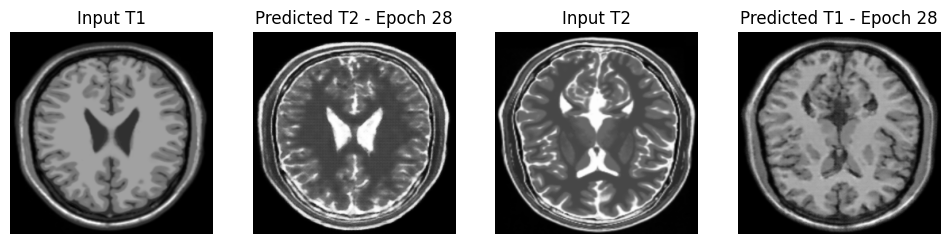

Time taken in 30 seconds for epoch 28



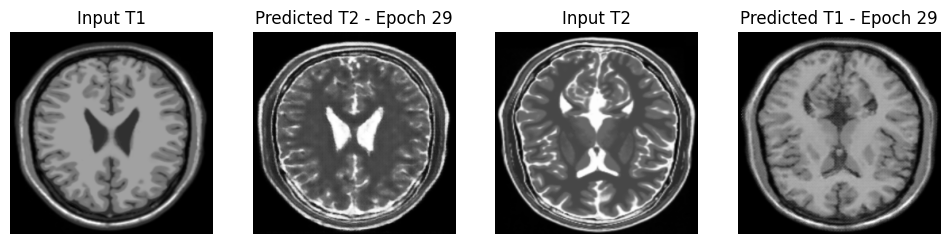

Time taken in 30 seconds for epoch 29



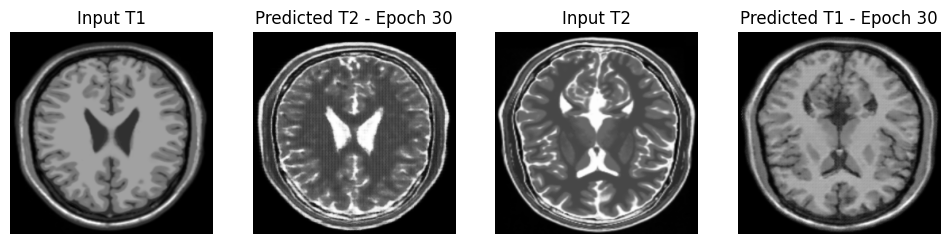

Checkpoint restored for epoch 30 at ./training_checkpoints/ckpt-3
Time taken in 38 seconds for epoch 30



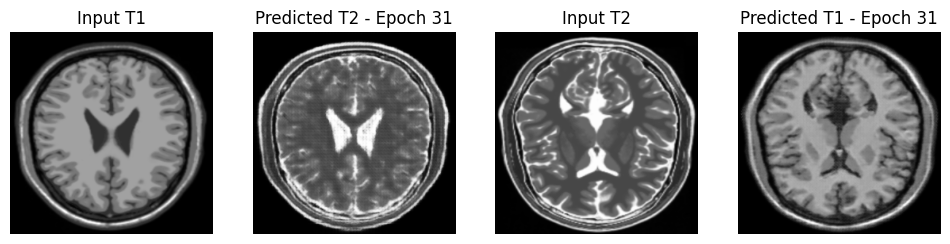

Time taken in 30 seconds for epoch 31



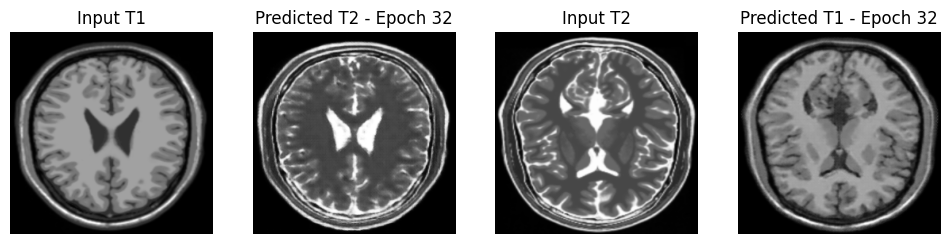

Time taken in 30 seconds for epoch 32



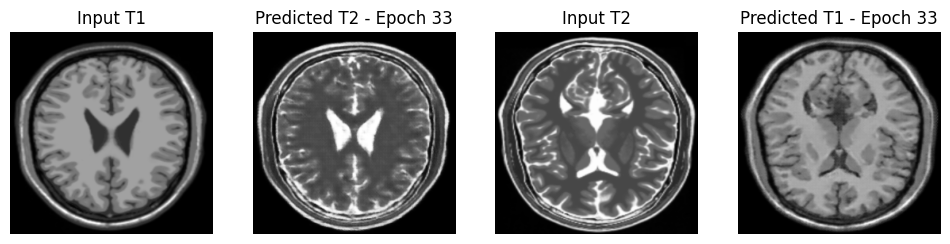

Time taken in 30 seconds for epoch 33



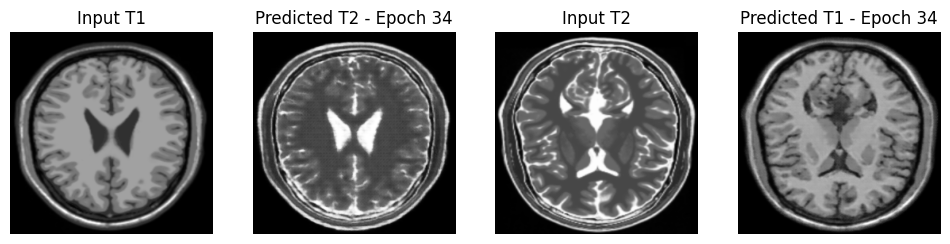

Time taken in 30 seconds for epoch 34



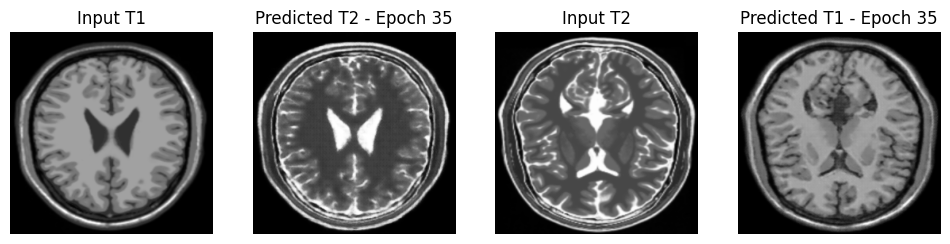

Time taken in 30 seconds for epoch 35



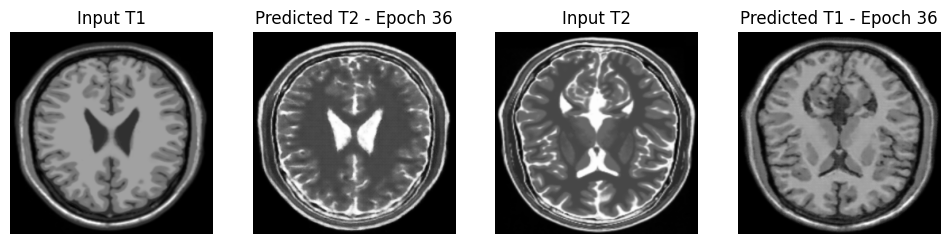

Time taken in 30 seconds for epoch 36



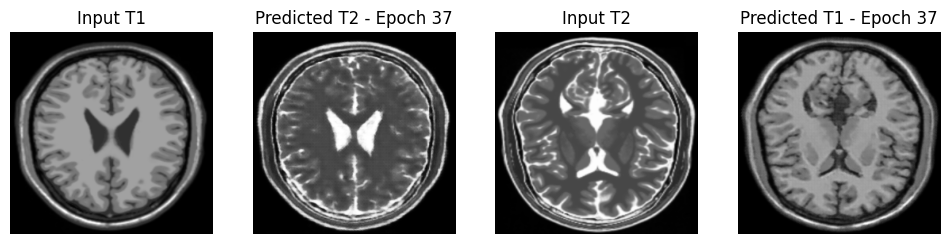

Time taken in 30 seconds for epoch 37



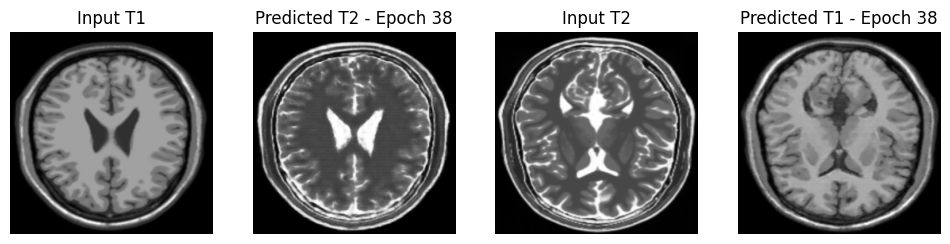

Time taken in 30 seconds for epoch 38



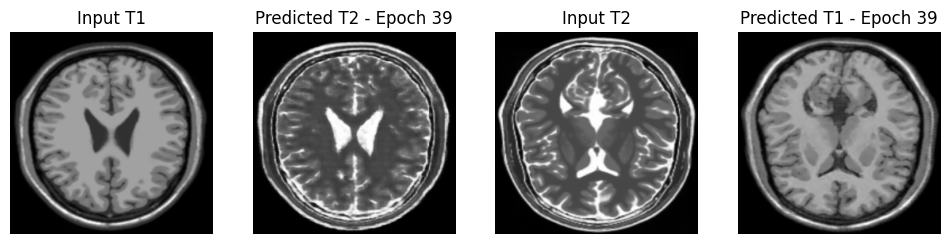

Time taken in 30 seconds for epoch 39



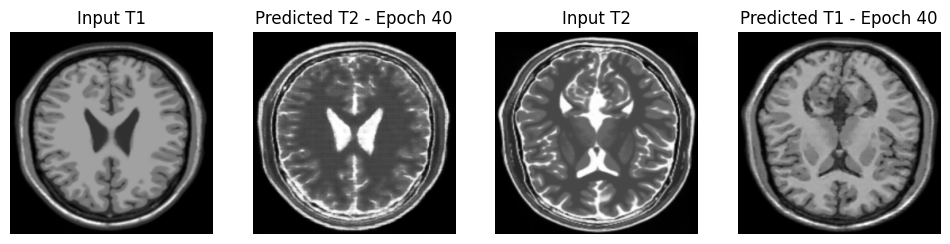

Checkpoint restored for epoch 40 at ./training_checkpoints/ckpt-4
Time taken in 38 seconds for epoch 40



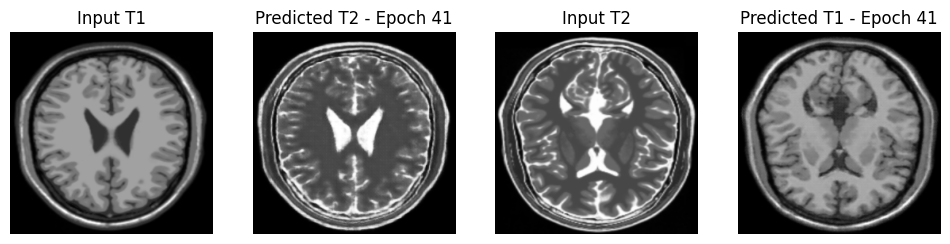

Time taken in 30 seconds for epoch 41



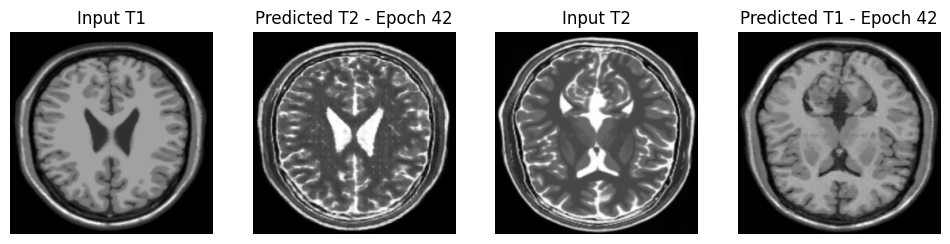

Time taken in 30 seconds for epoch 42



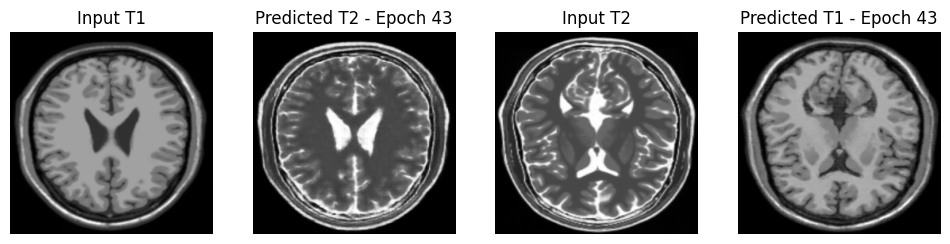

Time taken in 30 seconds for epoch 43



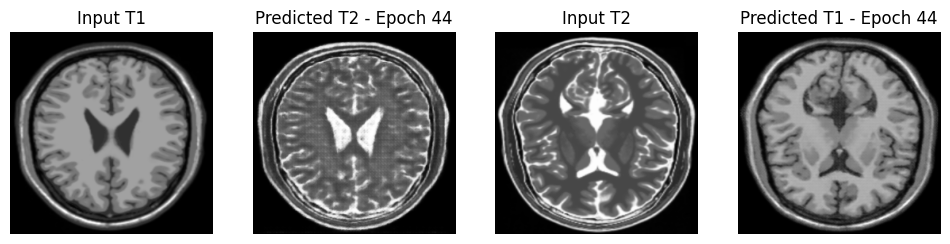

Time taken in 30 seconds for epoch 44



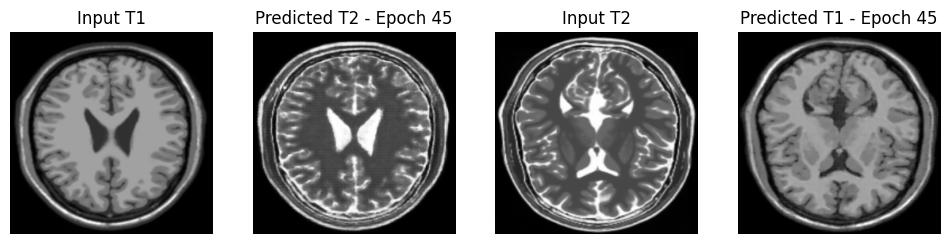

Time taken in 30 seconds for epoch 45



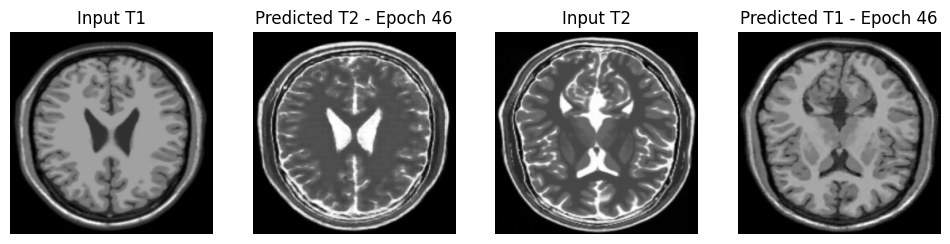

Time taken in 30 seconds for epoch 46



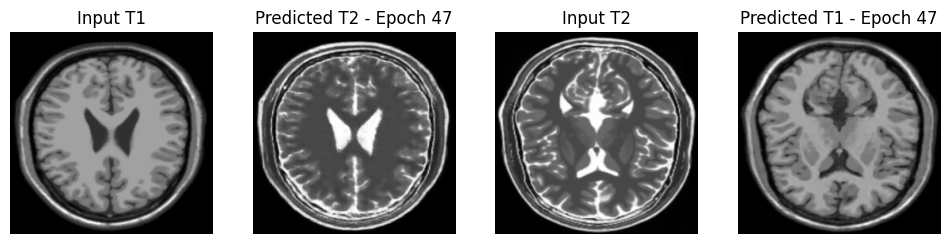

Time taken in 30 seconds for epoch 47



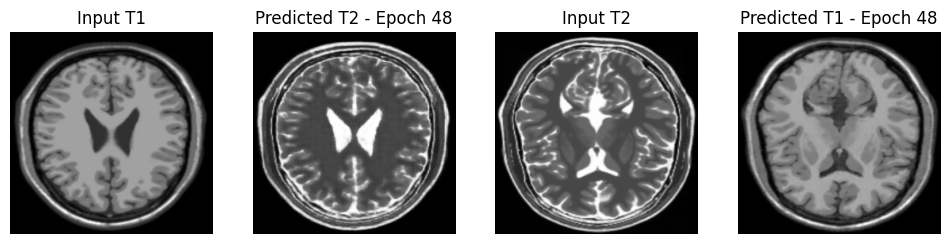

Time taken in 30 seconds for epoch 48



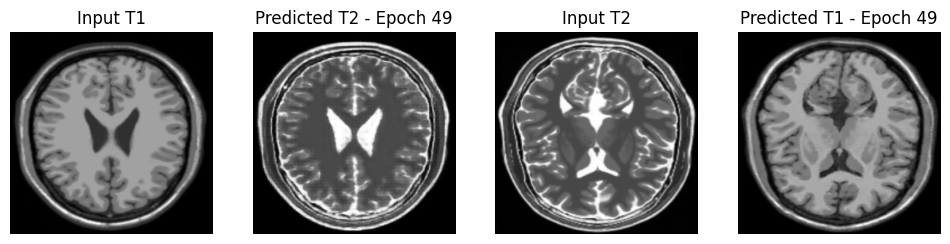

Time taken in 30 seconds for epoch 49



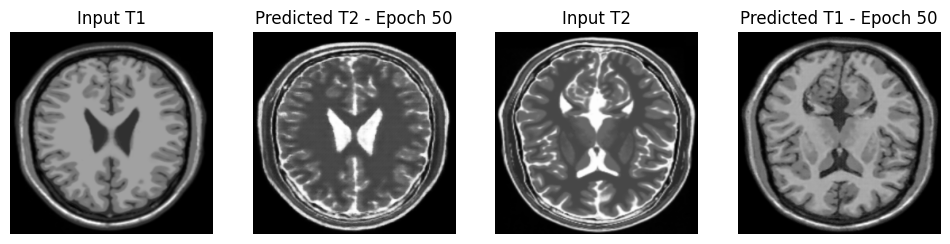

Checkpoint restored for epoch 50 at ./training_checkpoints/ckpt-5
Time taken in 38 seconds for epoch 50



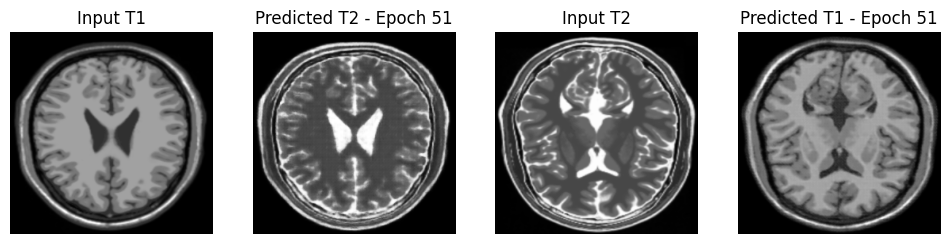

Time taken in 30 seconds for epoch 51



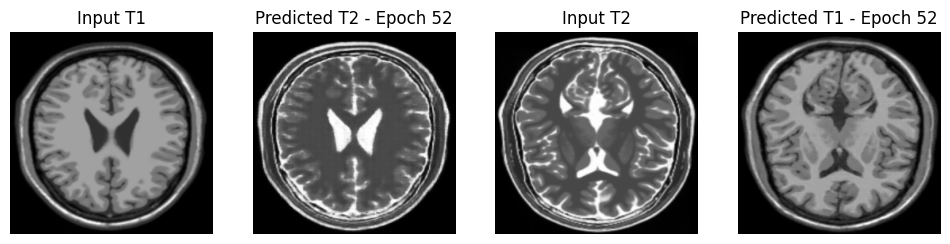

Time taken in 30 seconds for epoch 52



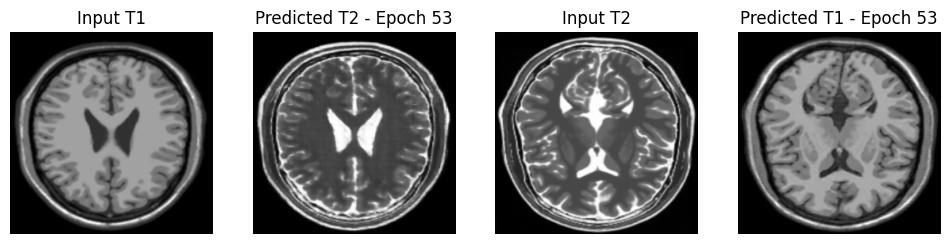

Time taken in 30 seconds for epoch 53



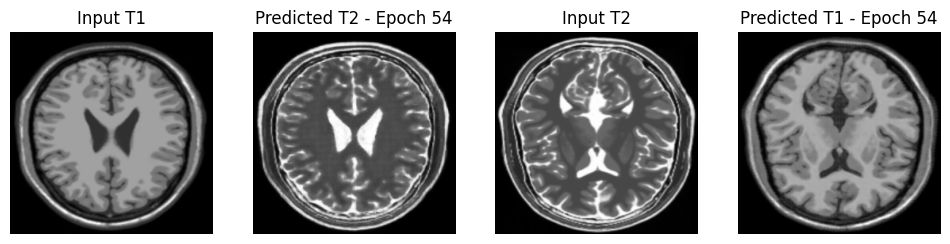

Time taken in 30 seconds for epoch 54



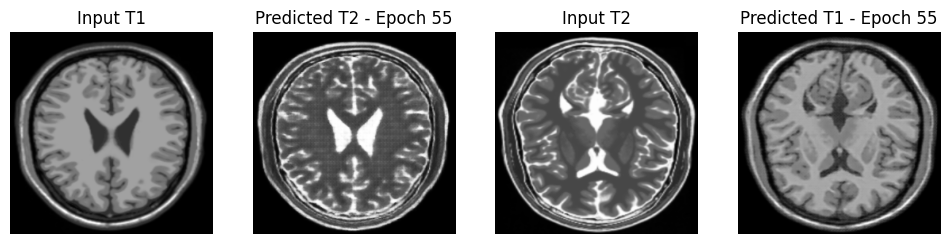

Time taken in 30 seconds for epoch 55



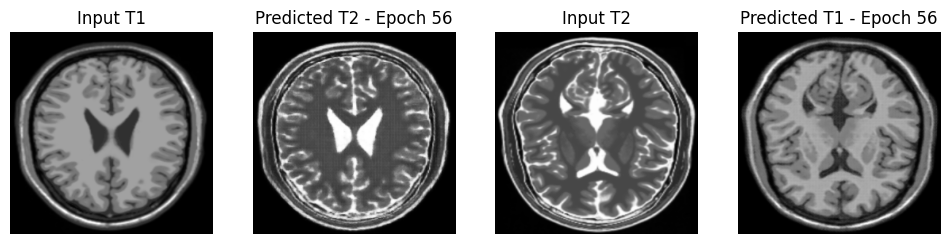

Time taken in 30 seconds for epoch 56



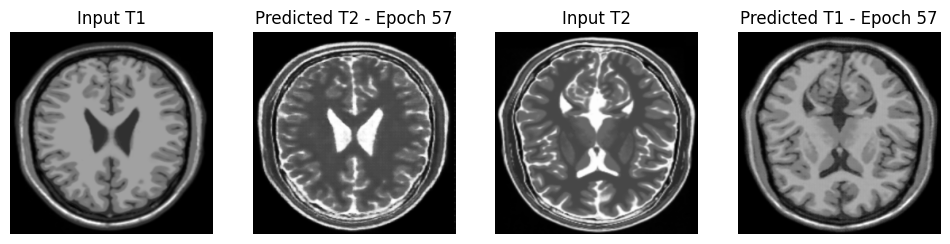

Time taken in 31 seconds for epoch 57



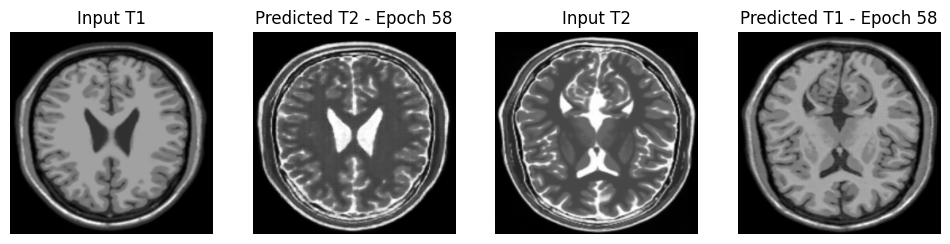

Time taken in 30 seconds for epoch 58



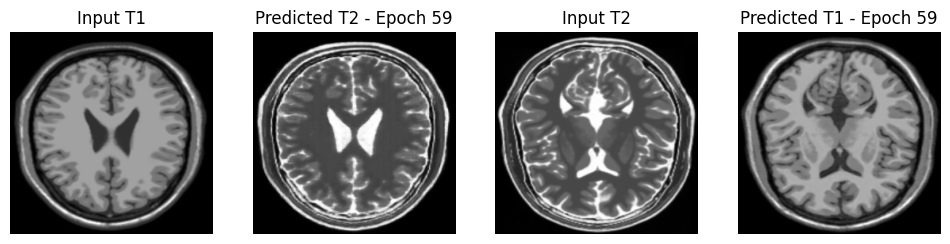

Time taken in 30 seconds for epoch 59



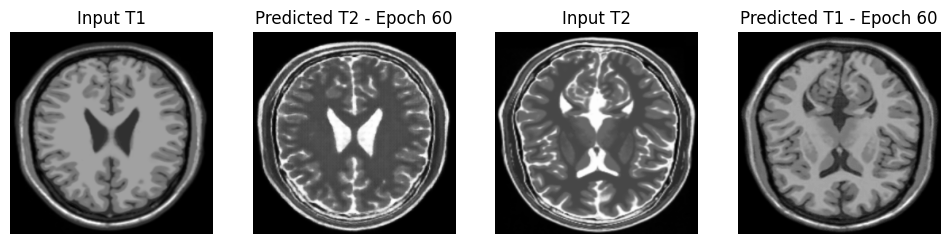

Checkpoint restored for epoch 60 at ./training_checkpoints/ckpt-6
Time taken in 38 seconds for epoch 60



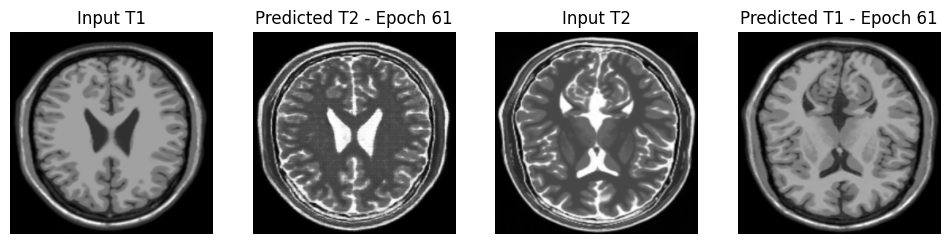

Time taken in 30 seconds for epoch 61



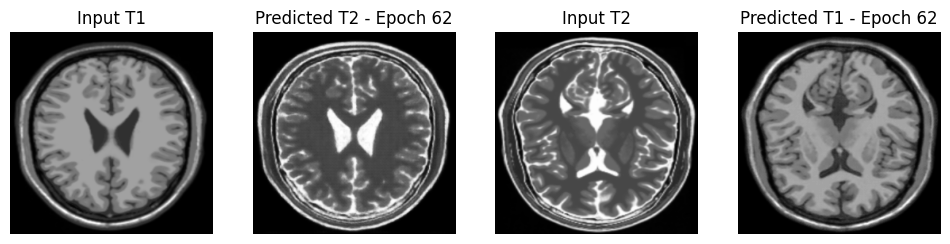

Time taken in 30 seconds for epoch 62



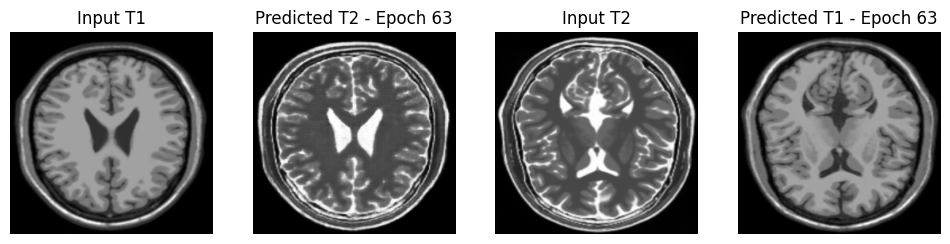

Time taken in 30 seconds for epoch 63



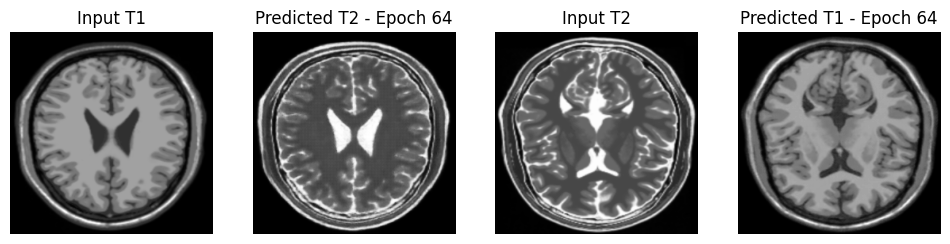

Time taken in 30 seconds for epoch 64



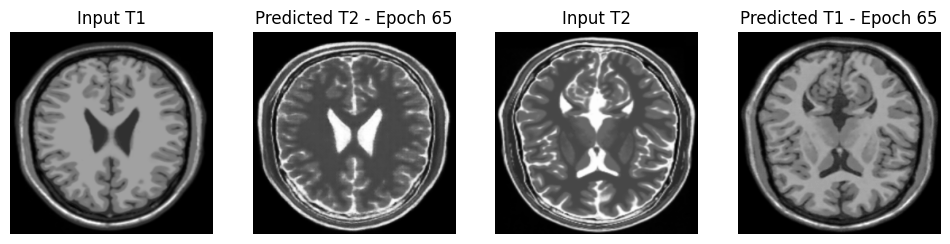

Time taken in 30 seconds for epoch 65



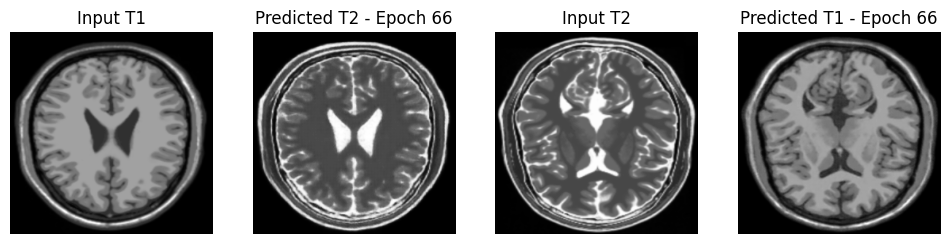

Time taken in 30 seconds for epoch 66



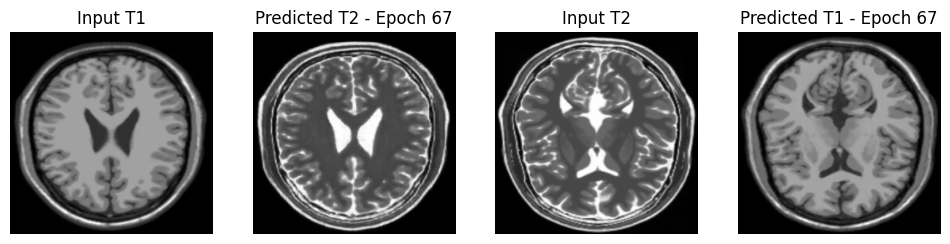

Time taken in 30 seconds for epoch 67



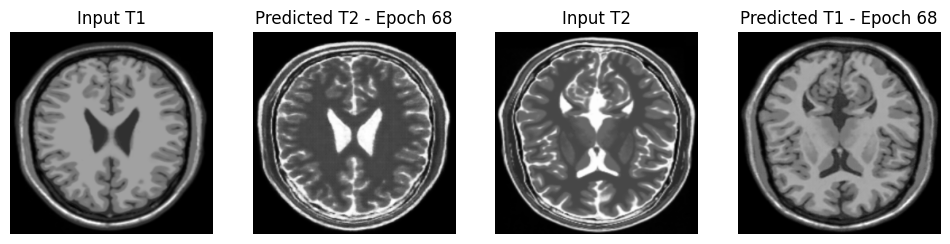

Time taken in 30 seconds for epoch 68



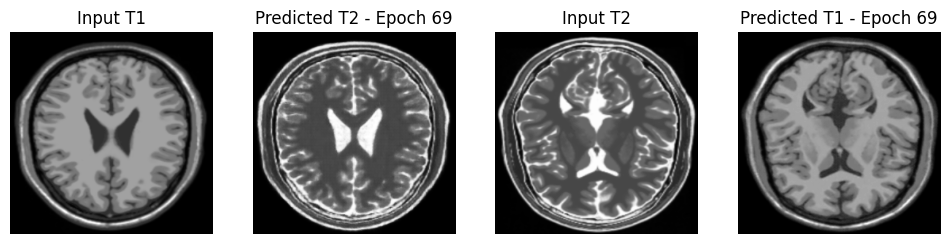

Time taken in 30 seconds for epoch 69



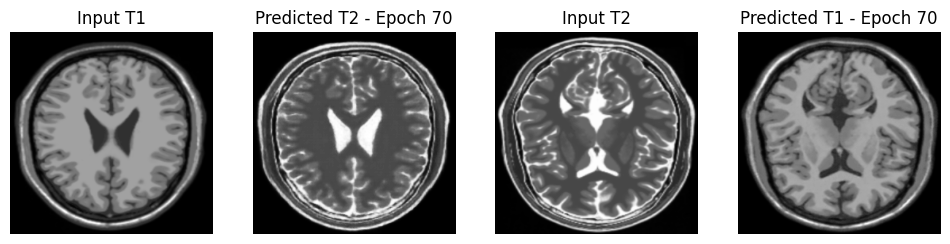

Checkpoint restored for epoch 70 at ./training_checkpoints/ckpt-7
Time taken in 39 seconds for epoch 70



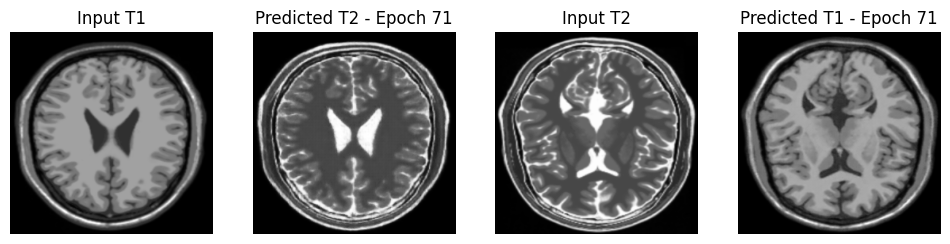

Time taken in 30 seconds for epoch 71



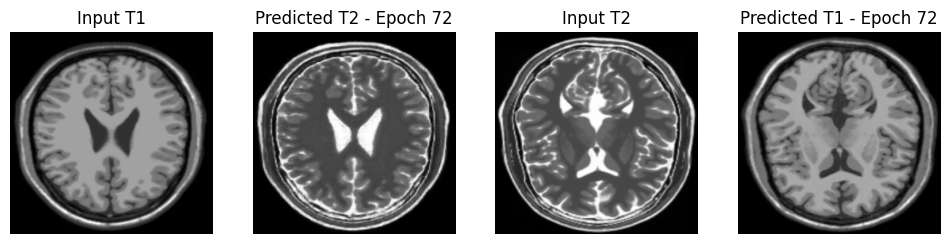

Time taken in 30 seconds for epoch 72



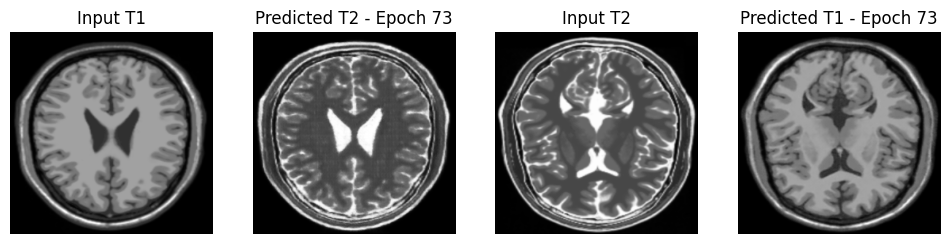

Time taken in 30 seconds for epoch 73



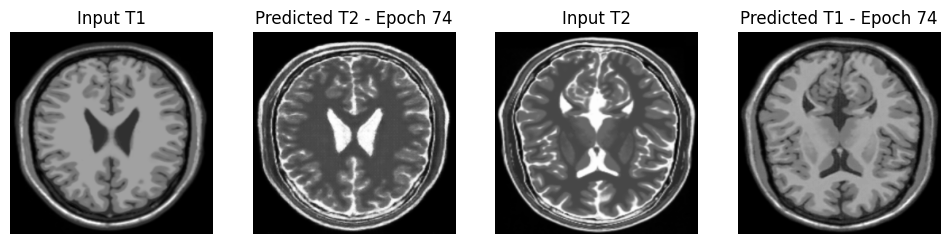

Time taken in 30 seconds for epoch 74



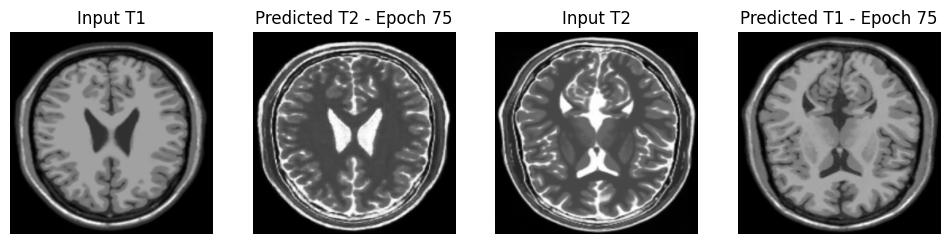

Time taken in 30 seconds for epoch 75



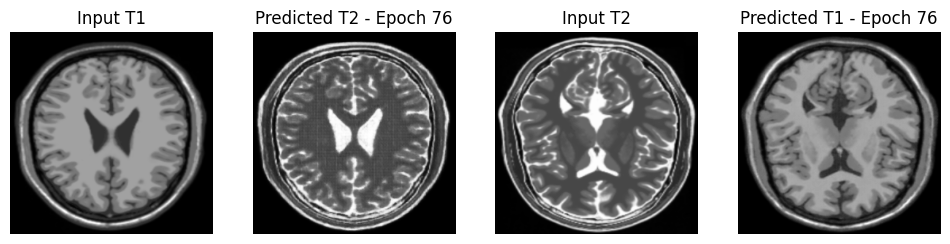

Time taken in 31 seconds for epoch 76



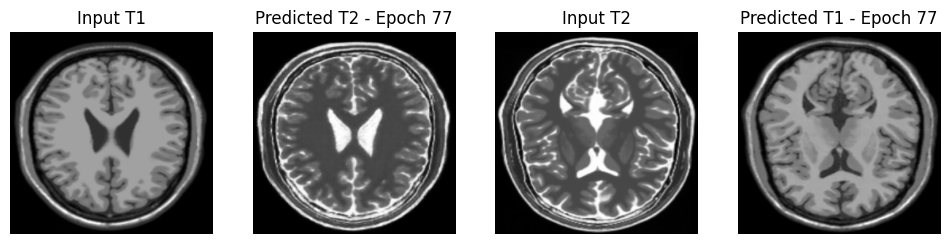

Time taken in 30 seconds for epoch 77



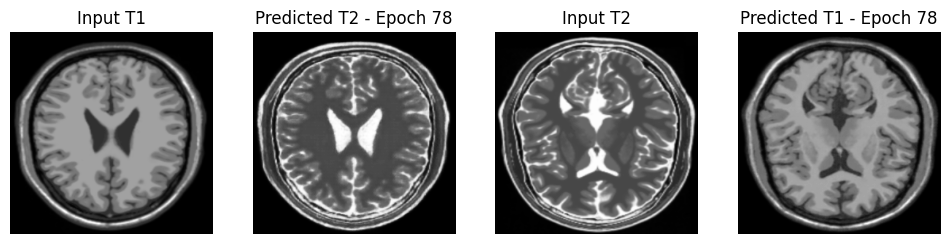

Time taken in 30 seconds for epoch 78



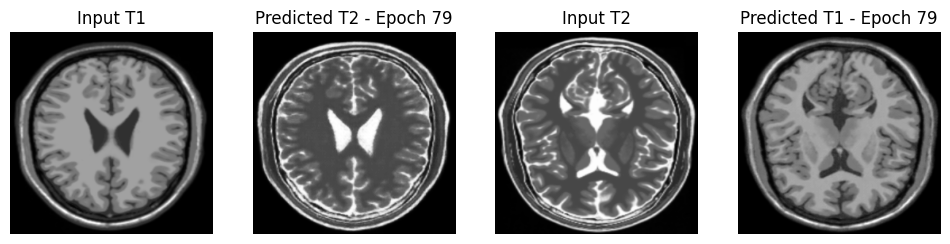

Time taken in 30 seconds for epoch 79



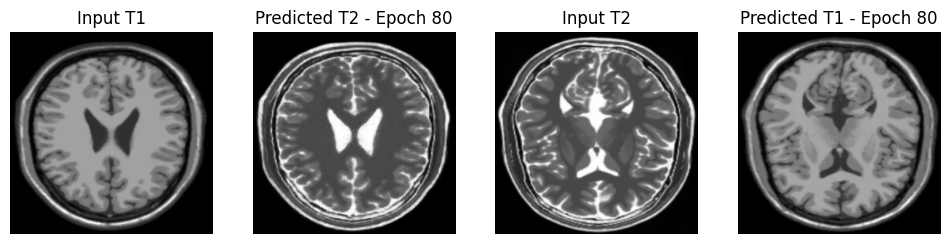

Checkpoint restored for epoch 80 at ./training_checkpoints/ckpt-8
Time taken in 38 seconds for epoch 80



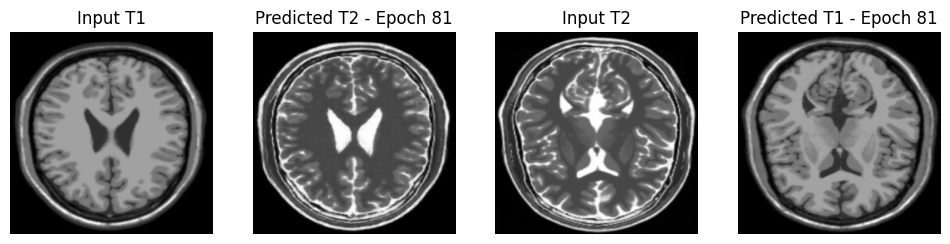

Time taken in 30 seconds for epoch 81



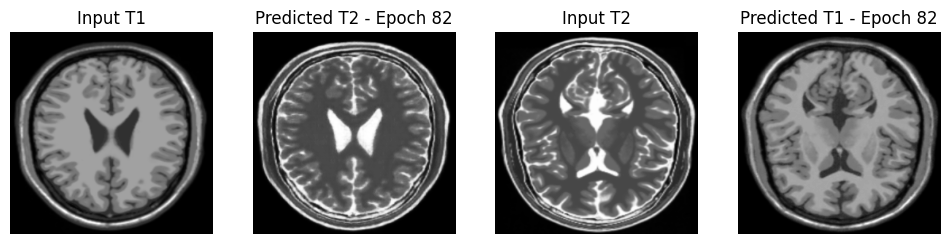

Time taken in 30 seconds for epoch 82



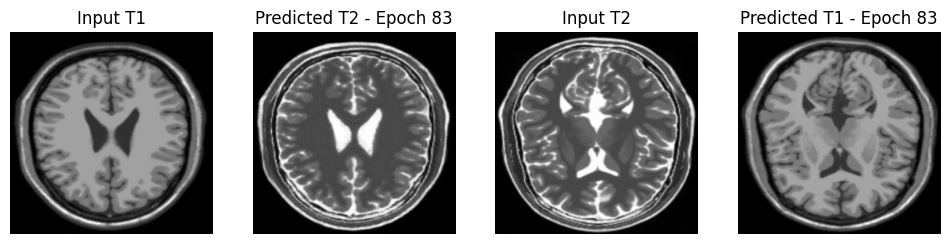

Time taken in 30 seconds for epoch 83



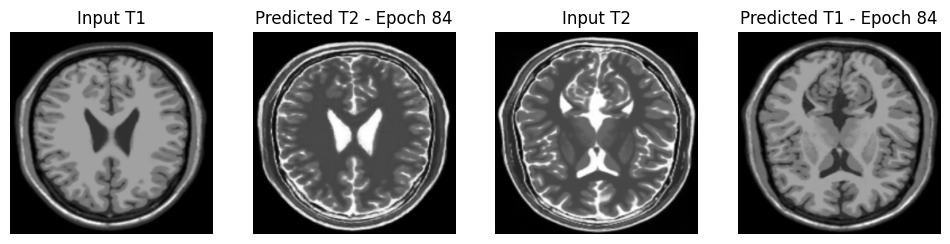

Time taken in 30 seconds for epoch 84



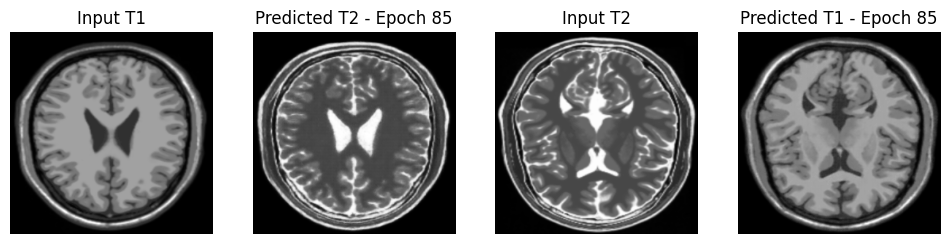

Time taken in 30 seconds for epoch 85



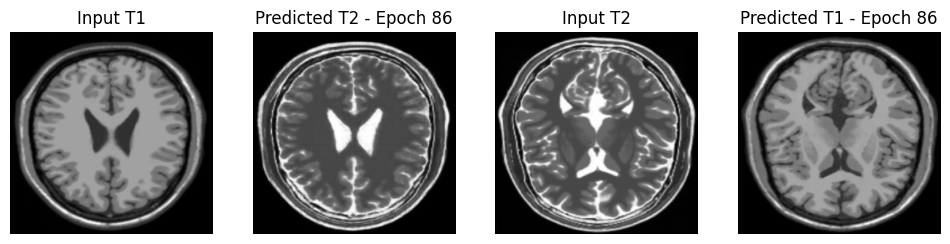

Time taken in 30 seconds for epoch 86



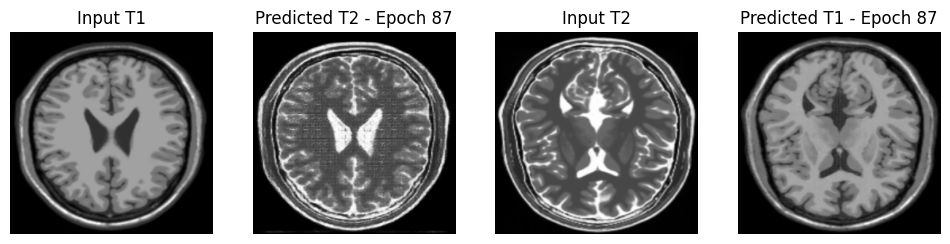

Time taken in 30 seconds for epoch 87



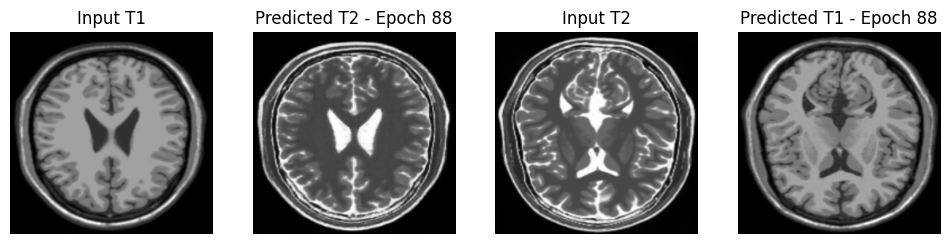

Time taken in 30 seconds for epoch 88



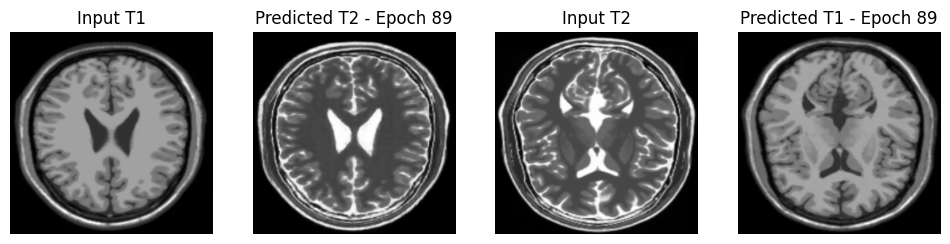

Time taken in 30 seconds for epoch 89



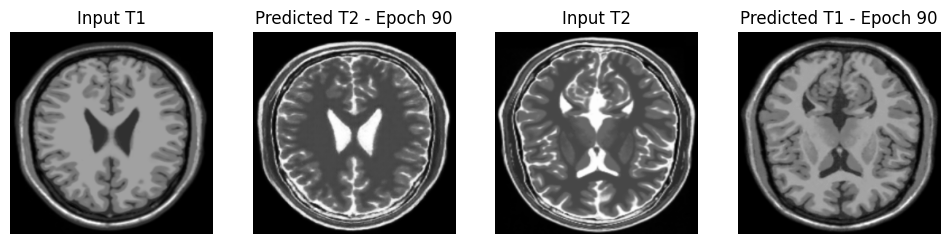

Checkpoint restored for epoch 90 at ./training_checkpoints/ckpt-9
Time taken in 39 seconds for epoch 90



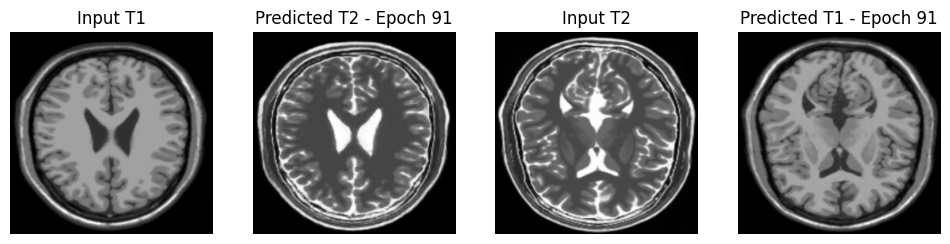

Time taken in 30 seconds for epoch 91



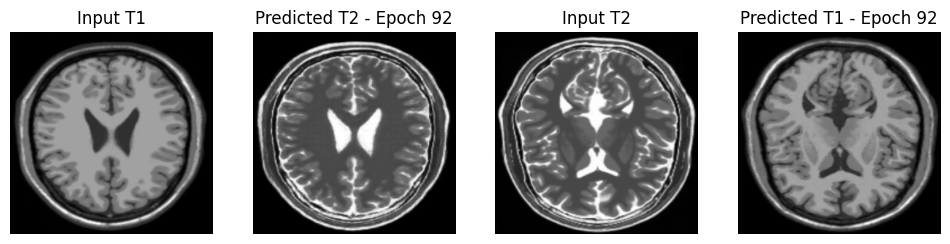

Time taken in 30 seconds for epoch 92



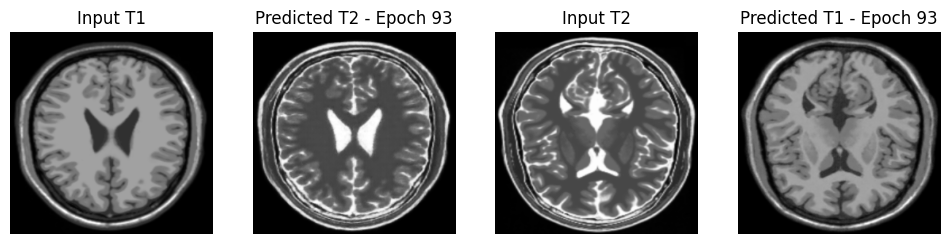

Time taken in 30 seconds for epoch 93



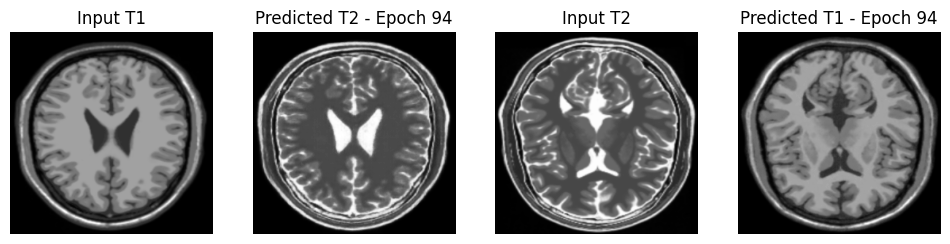

Time taken in 30 seconds for epoch 94



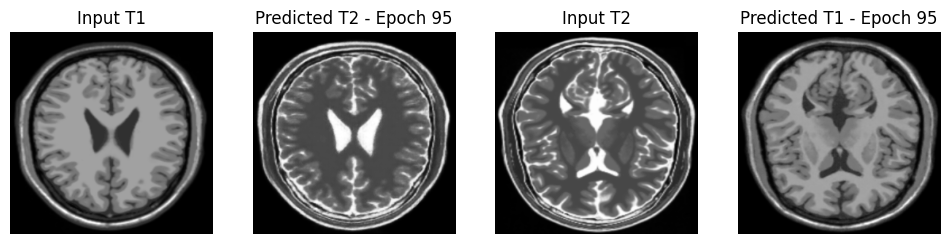

Time taken in 30 seconds for epoch 95



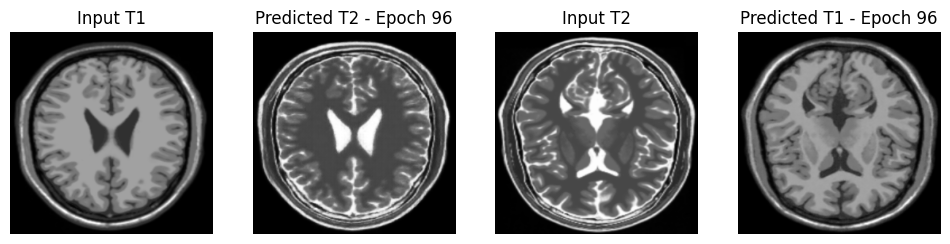

Time taken in 30 seconds for epoch 96



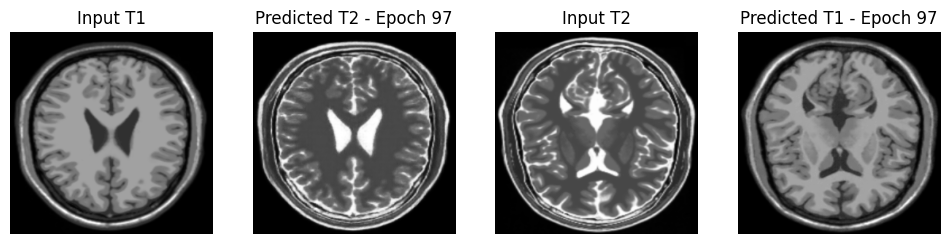

Time taken in 30 seconds for epoch 97



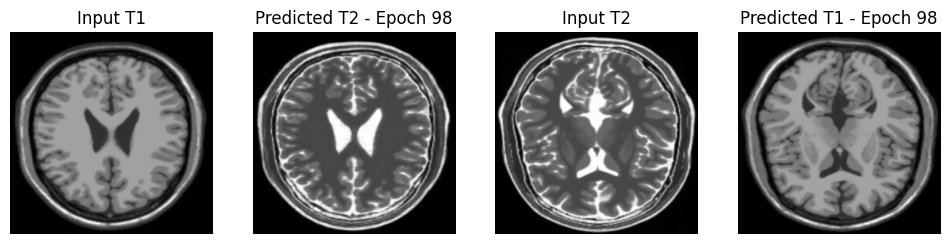

Time taken in 30 seconds for epoch 98



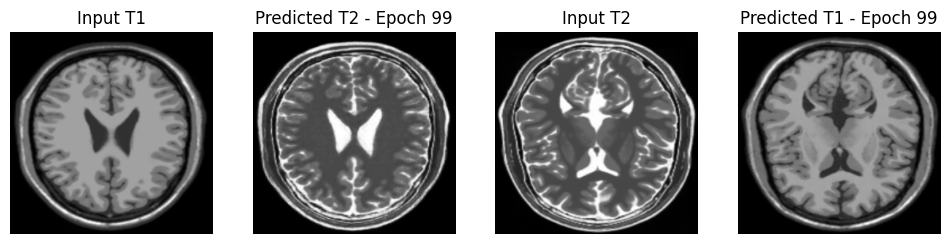

Time taken in 30 seconds for epoch 99



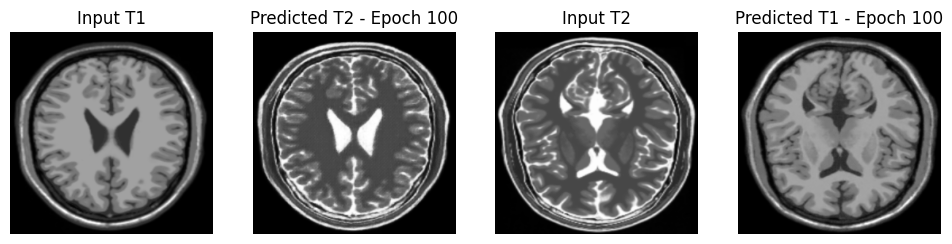

Checkpoint restored for epoch 100 at ./training_checkpoints/ckpt-10


trained models saved at 000100
Time taken in 40 seconds for epoch 100



In [ ]:
# training the model
for epoch in range(EPOCHS):
  start = time.time() 
  for image_x, image_y in tf.data.Dataset.zip((T1, T2)): # preprocessed input
    train_step(image_x, image_y)
  if (epoch + 1) % 1 == 0:
    generate_images(generator_g, sample_T1, generator_f, sample_T2) # generates input and syntetic images
  if (epoch + 1) % 10 == 0:
    checkpoint_save_path = checkpoint_manager.save() # checkpoint saved for every 10 epochs in the given path
    print('Checkpoint restored for epoch {} at {}'.format(epoch+1, checkpoint_save_path))
  if (epoch + 1) == EPOCHS:
    final_model_save(epoch, generator_g, generator_f) # the last model is saved n the given path for further use
  print('Time taken in {} seconds for epoch {}\n'.format(round(time.time()-start),epoch + 1))

### **Result:**   
After 100 epochs, the results are pretty good. The predicted images have a good likeness to their respective input image in terms of content, while having the style of the other image type.

- Predicted T2 has the features of input T1 in the style of T2.
- Predicted T1 has the features of input T2 in the style of T1.

### **Checking Trained Model**  

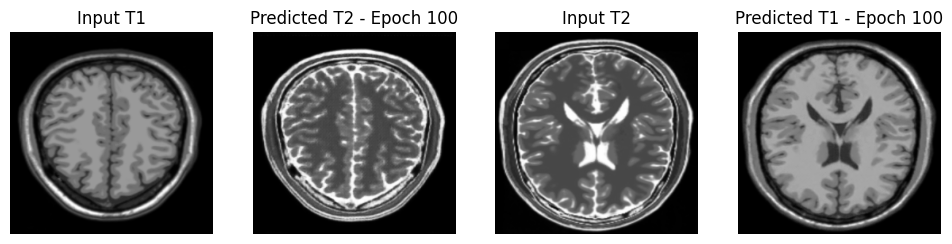

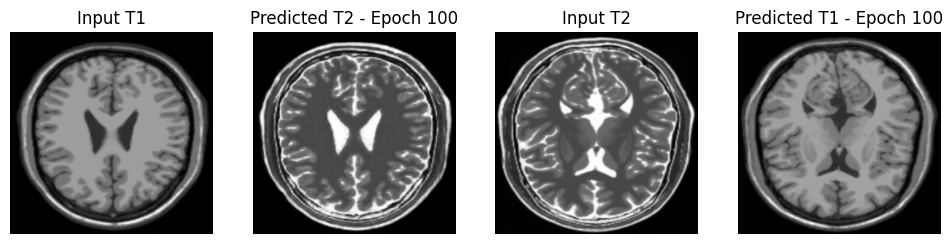

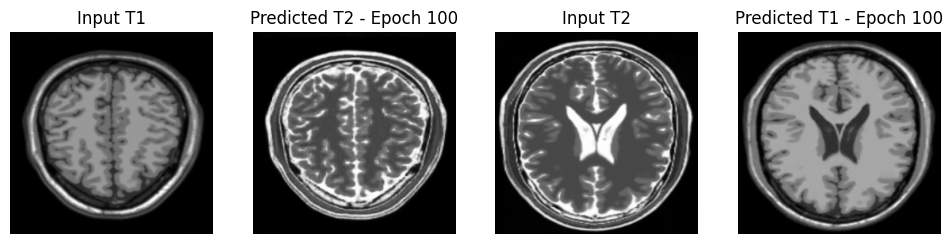

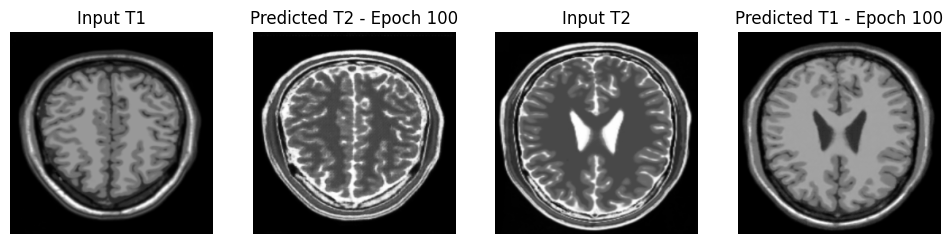

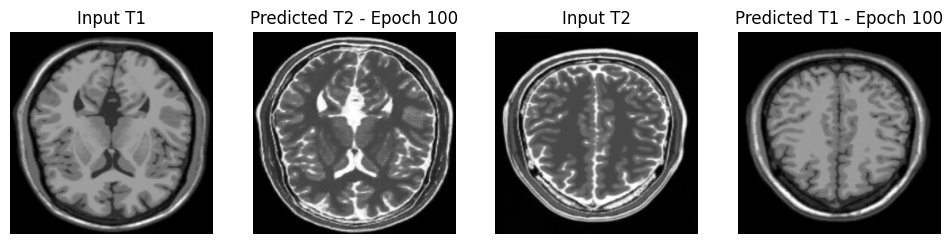

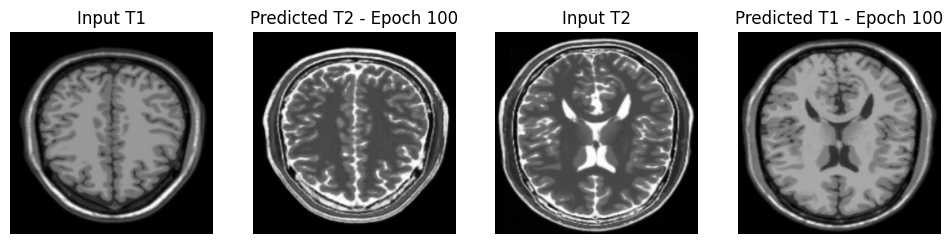

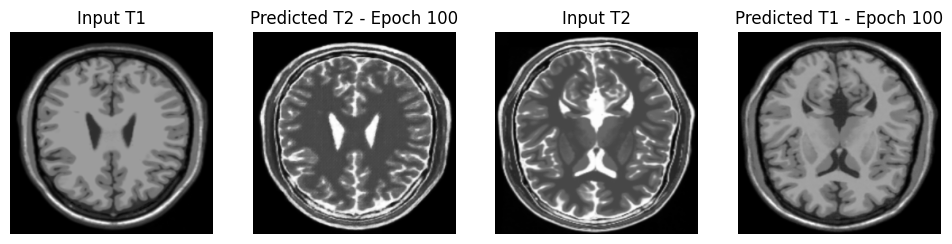

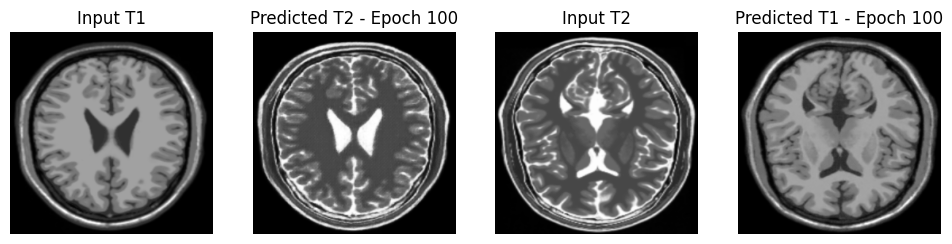

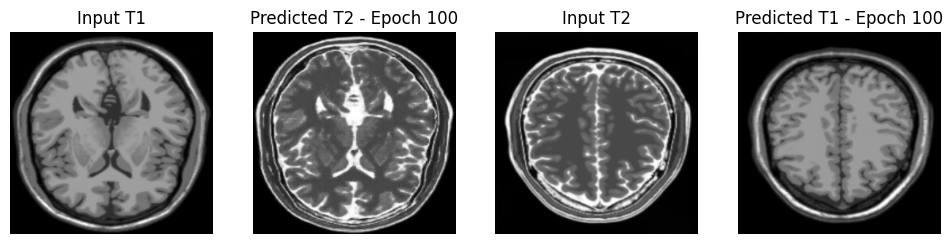

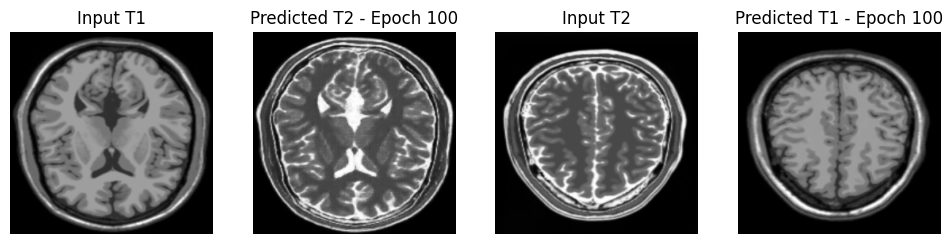

In [ ]:
# check the trained model on different images and check the output
import itertools
for (T1,T2) in itertools.zip_longest(T1.take(10), T2.take(10)):
  generate_images(generator_g, T1, generator_f, T2)

## **Testing the Final Model**   
Verifying the model by converting the synthetic images back to original and comparing the input image (verifying cycle consistency)

In [ ]:
# view synthetic images 
def compare_images(model_1, model_2, input):
  synthetic_image = model_1(input)
  reconstructed_image = model_2(synthetic_image)
  img_array = [input[0], synthetic_image[0], reconstructed_image[0]]
  img_title = ['Input Image', 'Synthetic Image', 'Reconstructed(cycled) Image']
  plt.figure(figsize=(12,9))
  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(img_title[i])
    plt.imshow(img_array[i].numpy()[:, :, 0], cmap='gray')
  plt.show()

In [ ]:
from keras.models import load_model

custom_object = {'InstanceNormalization': InstanceNormalization} # custom_objects argument

# load models
model_1 = load_model('/content/model_save/T1_to_T2_final_model.h5', custom_object)
model_2 = load_model('/content/model_save/T2_to_T1_final_model.h5', custom_object)

Using T1 data

T1 (input)  →  T2 (synthetic)  →  T1 (reconstructed)

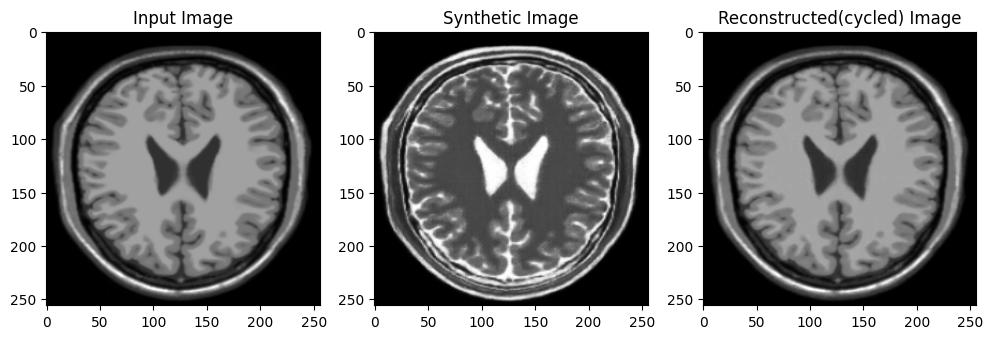

In [ ]:
compare_images(model_1, model_2, sample_T1)

Using T2 data

T2 (input)  →  T1 (synthetic)  →  T2 (reconstructed)

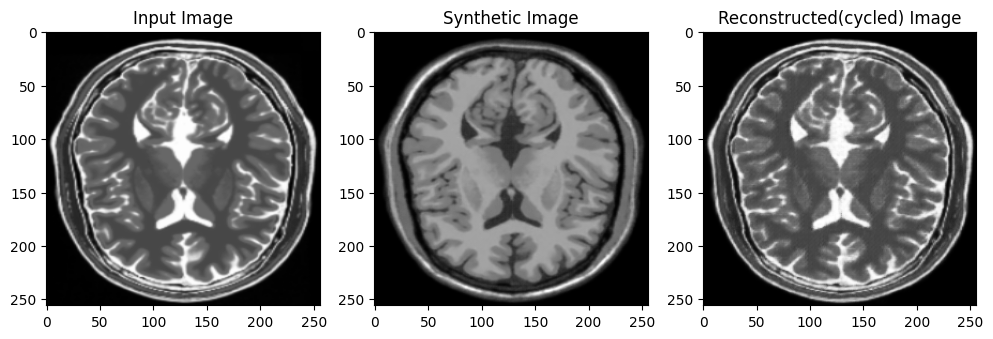

In [ ]:
compare_images(model_2, model_1, sample_T2)

**Conclusion:**  Through visual inspection, we can confirm that the reconstructed image is similar to the input image

### **Generating a GIF for visualization of Results**

In [ ]:
# Finally creating an animation to see how the style transfer happened across all epochs for both T1 and T2

anim_file = 'animated_cycleGAN_%d_epochs.gif' % (EPOCHS) # animation image name (GIF format)

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

In [ ]:
# installing tensorflow docs
!pip install git+https://github.com/tensorflow/docs --quiet


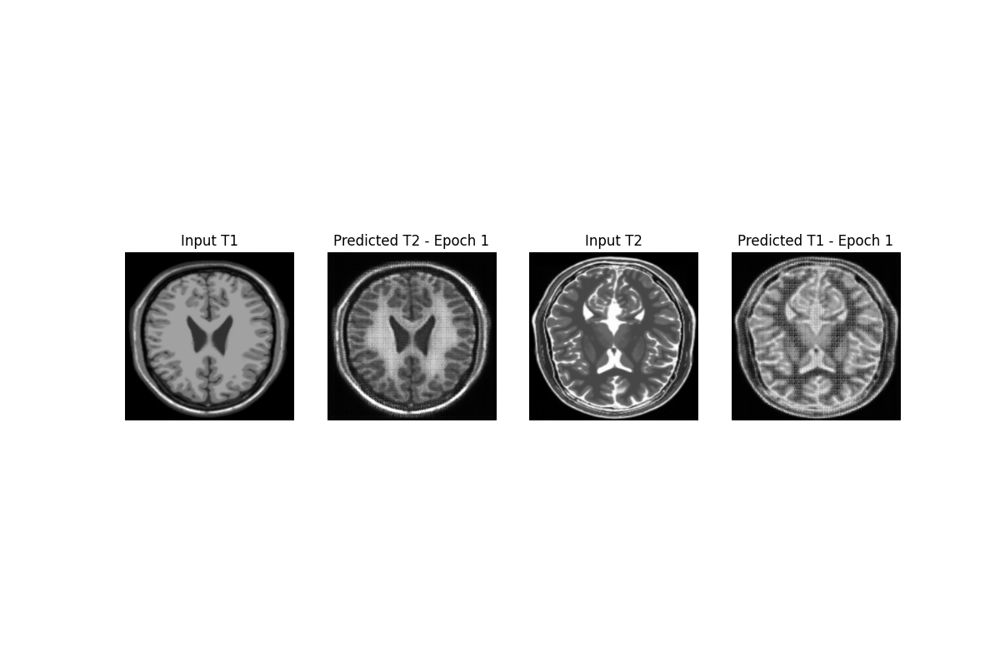

In [ ]:
# Visualizing the progress from epoch to epoch 
# Verifying the created animation for trained images
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

### **Conclusion**   
- We can see that a Cycle GAN architecture is effective in translating the style of T1 weighted MRI images to T2 weighted MRI image inputs, and vice versa.
- This can be very useful in more effective diagnosis, without the need of a second MRI scan. This not only saves time for the doctors, but would also reduce the financial burden on the patients.

#### **End of Project**  